In [146]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [86]:
df = pd.read_csv('input/2023Jan1-2023Nov30AmznSalesReportR.csv')

In [87]:
df

,date/time,settlement id,type,order id,sku,description,quantity,marketplace,account type,fulfillment,...,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees,other,total
0,"Jan 1, 2023 12:05:51 AM PST",17143526261,Order,114-8903434-9421842,794261051,Markal 61051 Quik Stik Twist Long-Lasting Soli...,1.0,amazon.com,Invoiced Orders,Seller,...,0,0,0.00,0,0.00,-6.60,0.00,0.0,0,37.39
1,"Jan 1, 2023 12:07:07 AM PST",17143526261,Order,112-6915314-5588210,794261069,Markal 61069 Quik Stik Twist Long-Lasting Soli...,1.0,amazon.com,Invoiced Orders,Seller,...,0,0,0.00,0,-3.98,-6.45,0.00,0.0,0,36.54
2,"Jan 1, 2023 12:07:21 AM PST",17143526261,Order,112-5352665-5232230,261185076,"GEARWRENCH 3/8"" Drive Electronic Torque Wrench...",1.0,amazon.com,Invoiced Orders,Seller,...,0,0,0.00,0,-8.82,-18.90,0.00,0.0,0,107.09
3,"Jan 1, 2023 12:09:44 AM PST",17143526261,Order,114-8440835-2746605,859512276,"Weiler 12276 5"" Single Row Knot Wire Cup Brush...",5.0,amazon.com,Invoiced Orders,Seller,...,0,0,0.00,0,0.00,-30.75,0.00,0.0,0,174.20
4,"Jan 1, 2023 12:11:27 AM PST",17143526261,Order,114-0207661-8985812,794296961,Markal - 96961 Pro-Line HP High Performance Li...,1.0,amazon.com,Invoiced Orders,Seller,...,0,0,0.00,0,0.00,-4.35,0.00,0.0,0,24.64
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45976,"Nov 30, 2023 11:38:44 PM PST",19201956281,Order,111-1594656-8635414,806088489fba,"3M Xtract Cubitron II Net Disc 710W, 220+, 3 i...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.00,0,-1.51,-3.12,-4.16,0.0,0,13.49
45977,"Nov 30, 2023 11:38:44 PM PST",19201956281,Order,113-2626300-0465837,147512162fba,"Lufkin Shockforce G2 16-ft Nite Eye, Magnetic ...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.00,0,-1.75,-3.74,-5.70,0.0,0,15.50
45978,"Nov 30, 2023 11:41:29 PM PST",19201956281,Order,114-4344818-4509042,261185195fba,"GEARWRENCH 3/8"" 120XP Flex Head Electronic Tor...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,-8.56,0,-13.19,-29.31,-11.99,0.0,0,154.12
45979,"Nov 30, 2023 11:54:36 PM PST",19201956281,Order,111-6046110-5737833,806088456fba,"Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.00,0,-3.21,-4.70,-5.70,0.0,0,20.96


**Product sales, other, and total are objects**

Start by getting columns totals and percent of total  
get shipping label and advertising totals  
Groupby order id for less holistic view

make type column name if == Shipping Services or Service fee and description with other total as row value

In [88]:
df.describe()

,settlement id,quantity,product sales tax,shipping credits,shipping credits tax,gift wrap credits,giftwrap credits tax,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees
count,4.598100e+04,33325.000000,45981.000000,45981.000000,45981.000000,45981.000000,45981.000000,45981.0,45981.0,45981.000000,45981.0,45981.000000,45981.000000,45981.000000,45981.000000
mean,1.810669e+10,1.275739,2.222751,0.365007,0.013721,0.000261,0.000005,0.0,0.0,-0.114659,0.0,-2.236478,-5.352911,-2.296403,-0.714061
std,6.036314e+08,1.758182,4.888575,2.714422,0.172745,0.041649,0.001166,0.0,0.0,0.731139,0.0,5.097190,11.383155,3.413559,18.676275
min,1.714353e+10,1.000000,-101.550000,-72.490000,-3.250000,0.000000,0.000000,0.0,0.0,-39.300000,0.0,-210.000000,-507.100000,-63.960000,-540.460000
25%,1.755036e+10,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,-2.480000,-5.120000,-4.750000,0.000000
50%,1.805434e+10,1.000000,1.630000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,-1.580000,-3.450000,0.000000,0.000000
75%,1.866063e+10,1.000000,2.480000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
max,1.920196e+10,100.000000,210.000000,100.240000,8.270000,7.990000,0.250000,0.0,0.0,9.290000,0.0,101.550000,307.000000,25.540000,0.000000


In [89]:
df.marketplace.unique()

array(['amazon.com', nan, 'Amazon.com', 'sim1.stores.amazon.com'],
      dtype=object)

In [90]:
df.loc[df['marketplace']=='sim1.stores.amazon.com']

,date/time,settlement id,type,order id,sku,description,quantity,marketplace,account type,fulfillment,...,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees,other,total
17189,"Apr 22, 2023 8:27:11 PM PDT",17801558341,Order,S01-7596915-4692413,806088758fba,"3M Xtract Electric Random Orbital Sander, Ergo...",1.0,sim1.stores.amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,0.0,0.0,-11.36,0.0,0,-11.36


In [91]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45981 entries, 0 to 45980
Data columns (total 30 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   date/time                 45981 non-null  object 
 1   settlement id             45981 non-null  int64  
 2   type                      45981 non-null  object 
 3   order id                  45609 non-null  object 
 4   sku                       33477 non-null  object 
 5   description               45981 non-null  object 
 6   quantity                  33325 non-null  float64
 7   marketplace               33422 non-null  object 
 8   account type              45981 non-null  object 
 9   fulfillment               33100 non-null  object 
 10  order city                33094 non-null  object 
 11  order state               33054 non-null  object 
 12  order postal              33093 non-null  object 
 13  tax collection model      30232 non-null  object 
 14  produc

In [92]:
df['product sales']=df['product sales'].apply(lambda x: x.replace(',',''))
df['product sales'] = df['product sales'].astype(float)

In [93]:
df['other']=df['other'].apply(lambda x: x.replace(',',''))
df['other'] = df['other'].astype(float)

In [94]:
df['total']=df['total'].apply(lambda x: x.replace(',',''))
df['total'] = df['total'].astype(float)

In [38]:
grp = df.groupby('order id')

In [29]:

for name, group in grp:
    print(name)
    
    print(group)
    print()

/UyF5B6VmV
                          date/time  settlement id               type  \
32285  Aug 24, 2023 10:39:55 AM PDT    18566954581  FBA Inventory Fee   

         order id  sku                    description  quantity marketplace  \
32285  /UyF5B6VmV  NaN  FBA Removal Order: Return Fee       NaN  Amazon.com   

          account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
32285  Standard Orders         NaN  ...              0                     0   

      promotional rebates promotional rebates tax  marketplace withheld tax  \
32285                 0.0                       0                       0.0   

       selling fees  fba fees  other transaction fees  other  total  
32285           0.0       0.0                     0.0  -9.18  -9.18  

[1 rows x 30 columns]

111-0001136-4669806
                      date/time  settlement id               type  \
576  Jan 5, 2023 6:40:56 AM PST    17149362761              Order   
577  Jan 5, 2023 6:40:59 AM PST    171493

                        date/time  settlement id   type             order id  \
14700  Apr 5, 2023 1:53:40 PM PDT    17719575561  Order  111-0140384-3823461   

                sku                                        description  \
14700  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
14700       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
14700                     0               -1.49                       0   

       marketplace withheld tax  selling fees  fba fees  \
14700                     -2.24         -3.45     -4.75   

       other transaction fees  other  total  
14700                     0.0    0.0  14.79  

[1 rows x 30 columns]

111-0141044-2416210
                         date/time  settlement id               type  \
34718  Sep 13, 2023 1:01:35 PM PDT    18660627041  

                         date/time  settlement id   type             order id  \
22075  May 31, 2023 9:55:36 PM PDT    18054338581  Order  111-0296536-0121823   
22076  May 31, 2023 9:55:36 PM PDT    18054338581  Order  111-0296536-0121823   
22496  Jun 3, 2023 11:42:30 PM PDT    18054338581  Order  111-0296536-0121823   

                sku                                        description  \
22075  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   
22076  806088457fba  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...   
22496  806088455fba  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
22075       1.0  amazon.com  Standard Orders      Amazon  ...              0   
22076       1.0  amazon.com  Standard Orders      Amazon  ...              0   
22496       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotion

                         date/time  settlement id               type  \
7313  Feb 20, 2023 10:44:51 AM PST    17390577031              Order   
7314  Feb 20, 2023 10:45:03 AM PST    17390577031  Shipping Services   

                 order id        sku  \
7313  111-0448846-5857004  261185034   
7314  111-0448846-5857004        NaN   

                                            description  quantity marketplace  \
7313  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       1.0  amazon.com   
7314            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7313  Standard Orders      Seller  ...              0                     0   
7314  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7313                 0.0                       0                     -7.63   
7314                 0.0

                        date/time  settlement id   type             order id  \
9100  Feb 28, 2023 7:25:20 PM PST    17466329531  Order  111-0609899-7261850   

               sku                                        description  \
9100  806088472fba  3M Xtract Cubitron II Net Disc 710W, 150+, 5 i...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
9100       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
9100                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
9100                      -1.7         -3.45     -4.75   

      other transaction fees  other  total  
9100                     0.0    0.0  14.79  

[1 rows x 30 columns]

111-0610309-9757834
                        date/time  settlement id   type             order id  \
18504  May 4, 2023 9:11:11 AM PDT    17887625211  Ord

                          date/time  settlement id   type  \
19369  May 11, 2023 12:18:56 PM PDT    17887625211  Order   

                  order id           sku  \
19369  111-0759139-3299459  806088462fba   

                                             description  quantity  \
19369  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19369  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19369                     0               -0.74                       0   

       marketplace withheld tax  selling fees  fba fees  \
19369                     -3.02         -4.65      -5.4   

       other transaction fees  other  total  
19369                     0.0    0.0  20.94  

[1 rows x 30 columns]

111-0762143-7195457
                         date/time  settlement id   type             order id  \
32739  Aug 28, 2023

                         date/time  settlement id   type             order id  \
12188  Mar 17, 2023 8:10:58 PM PDT    17550355351  Order  111-0896030-5109040   
12189  Mar 17, 2023 8:10:58 PM PDT    17550355351  Order  111-0896030-5109040   

                sku                                        description  \
12188  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   
12189  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
12188       2.0  amazon.com  Standard Orders      Amazon  ...              0   
12189       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12188                     0                 0.0                       0   
12189                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
12188  

                        date/time  settlement id   type             order id  \
33286  Sep 1, 2023 7:57:05 AM PDT    18566954581  Order  111-1050157-4753826   

                sku                                        description  \
33286  794261043fba  Markal 61043 Quik Stik All Purpose Long-Lastin...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33286       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33286                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33286                     -4.75        -10.17     -4.75   

       other transaction fees  other  total  
33286                     0.0    0.0  52.88  

[1 rows x 30 columns]

111-1052117-6397804
                      date/time  settlement id               type  \
168  Jan 3, 2023 9:12:31 AM PST    17149362761  Shippi

                          date/time  settlement id   type  \
33232  Aug 31, 2023 11:14:05 PM PDT    18566954581  Order   

                  order id           sku  \
33232  111-1188497-3215458  794296964fba   

                                             description  quantity  \
33232  Markal 96964- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
33232  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33232                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33232                     -2.06         -5.13     -5.17   

       other transaction fees  other  total  
33232                     0.0    0.0  24.02  

[1 rows x 30 columns]

111-1189762-8760213
                        date/time  settlement id   type             order id  \
34054  Sep 8, 2023 9

                         date/time  settlement id               type  \
19940  May 17, 2023 7:20:14 AM PDT    17969819951  Shipping Services   
19941  May 17, 2023 7:20:31 AM PDT    17969819951              Order   

                  order id        sku  \
19940  111-1358602-4764223        NaN   
19941  111-1358602-4764223  806088455   

                                             description  quantity  \
19940            Shipping Label Purchased through Amazon       NaN   
19941  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19940         NaN  Standard Orders         NaN  ...              0   
19941  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19940                     0                 0.0                       0   
19941                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
21709  May 30, 2023 7:43:05 AM PDT    17969819951              Order   
21713  May 30, 2023 7:47:29 AM PDT    17969819951  Shipping Services   

                  order id        sku  \
21709  111-1526802-0573051  806088456   
21713  111-1526802-0573051        NaN   

                                             description  quantity  \
21709  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   
21713            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
21709  amazon.com  Standard Orders      Seller  ...              0   
21713         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21709                     0                 0.0                       0   
21713                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
30405  Aug 9, 2023 11:50:39 PM PDT    18479101141  Order  111-1686038-3106643   

                sku                                        description  \
30405  794261051fba  Markal 61051 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
30405       2.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30405                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
30405                     -7.78        -17.96      -9.5   

       other transaction fees  other  total  
30405                     0.0    0.0  92.32  

[1 rows x 30 columns]

111-1686381-4393851
                          date/time  settlement id               type  \
16252  Apr 14, 2023 12:08:00 PM PDT    177195755

                        date/time  settlement id   type             order id  \
43032  Nov 8, 2023 6:59:53 AM PST    19015309651  Order  111-1810388-0397042   

                sku                                        description  \
43032  794261050fba  Markal 61050 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
43032       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
43032                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
43032                     -3.16         -7.89      -5.7   

       other transaction fees  other  total  
43032                     0.0    0.0  39.02  

[1 rows x 30 columns]

111-1810868-3015428
                         date/time  settlement id   type             order id  \
26564  Jul 7, 2023 10:55:47 AM PDT    1822

                        date/time  settlement id               type  \
8856  Feb 28, 2023 8:55:29 AM PST    17466329531  Shipping Services   
8857  Feb 28, 2023 8:55:41 AM PST    17466329531              Order   

                 order id        sku  \
8856  111-1948889-3933018        NaN   
8857  111-1948889-3933018  806088458   

                                            description  quantity marketplace  \
8856            Shipping Label Purchased through Amazon       NaN         NaN   
8857  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
8856  Standard Orders         NaN  ...              0                     0   
8857  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
8856                 0.0                       0                      0.00   
8857                 0.0   

                          date/time  settlement id   type  \
21633   May 30, 2023 2:30:59 AM PDT    17969819951  Order   
21805  May 30, 2023 11:34:35 AM PDT    18054338581  Order   

                  order id           sku  \
21633  111-2082638-0584256  806088471fba   
21805  111-2082638-0584256  806088470fba   

                                             description  quantity  \
21633  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
21805  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
21633  amazon.com  Standard Orders      Amazon  ...              0   
21805  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21633                     0                 0.0                       0   
21805                     0                 0.0                       0   

       marketplace withheld tax  se

                         date/time  settlement id               type  \
26992  Jul 12, 2023 6:16:28 AM PDT    18308170881              Order   
27018  Jul 12, 2023 8:10:54 AM PDT    18308170881  Shipping Services   

                  order id        sku  \
26992  111-2234079-1448232  806088476   
27018  111-2234079-1448232        NaN   

                                             description  quantity  \
26992  3M Xtract Cubitron II Net Disc 710W, 320+, 5 i...       1.0   
27018            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
26992  amazon.com  Standard Orders      Seller  ...              0   
27018         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26992                     0                 0.0                       0   
27018                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
11452  Mar 14, 2023 6:56:46 AM PDT    17550355351  Shipping Services   
11453  Mar 14, 2023 6:57:12 AM PDT    17550355351              Order   

                  order id        sku  \
11452  111-2402682-9977862        NaN   
11453  111-2402682-9977862  806088456   

                                             description  quantity  \
11452            Shipping Label Purchased through Amazon       NaN   
11453  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
11452         NaN  Standard Orders         NaN  ...              0   
11453  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
11452                     0                 0.0                       0   
11453                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
33105  Aug 31, 2023 3:56:22 AM PDT    18566954581  Order  111-2574113-4893859   

                sku                                        description  \
33105  806088472fba  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33105       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33105                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33105                     -2.31         -3.96     -4.75   

       other transaction fees  other  total  
33105                     0.0    0.0   17.7  

[1 rows x 30 columns]

111-2575106-4249842
                         date/time  settlement id               type  \
36508  Sep 26, 2023 6:45:03 AM PDT    18749537461

                         date/time  settlement id   type             order id  \
31793  Aug 21, 2023 1:02:46 AM PDT    18479101141  Order  111-2736888-1005035   

                sku                                        description  \
31793  806088472fba  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
31793       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31793                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
31793                     -1.99          -4.5     -4.75   

       other transaction fees  other  total  
31793                     0.0    0.0  20.75  

[1 rows x 30 columns]

111-2737021-1688265
                       date/time  settlement id               type  \
9640  Mar 3, 2023 8:42:53 AM PST    17466329531  Sh

                        date/time  settlement id   type             order id  \
37813  Oct 5, 2023 4:38:26 AM PDT    18840635771  Order  111-2859954-7191403   

                sku                                        description  \
37813  794297050fba  Markal 97050 Paint-Riter Valve Action Paint Ma...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
37813       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
37813                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
37813                     -3.27          -5.7     -4.64   

       other transaction fees  other  total  
37813                     0.0    0.0  27.66  

[1 rows x 30 columns]

111-2860112-0158636
                         date/time  settlement id   type             order id  \
40375  Oct 21, 2023 8:17:32 PM PDT    1892

                         date/time  settlement id   type             order id  \
44329  Nov 18, 2023 8:57:29 PM PST    19109171271  Order  111-3007060-2109028   

                sku                                        description  \
44329  794297051fba  Markal 97051 Paint-Riter Valve Action Paint Ma...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
44329       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44329                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44329                       0.0         -4.34     -5.33   

       other transaction fees  other  total  
44329                     0.0    0.0  19.24  

[1 rows x 30 columns]

111-3007367-8569055
                        date/time  settlement id               type  \
26170  Jul 3, 2023 6:05:36 AM PDT    18221630821  

                        date/time  settlement id               type  \
2743  Jan 19, 2023 7:45:16 AM PST    17234809221              Order   
2744  Jan 19, 2023 7:45:16 AM PST    17234809221              Order   
2745  Jan 19, 2023 7:45:16 AM PST    17234809221              Order   
2746  Jan 19, 2023 7:45:19 AM PST    17234809221  Shipping Services   

                 order id        sku  \
2743  111-3142335-9253843  806088475   
2744  111-3142335-9253843  806088471   
2745  111-3142335-9253843  806088476   
2746  111-3142335-9253843        NaN   

                                            description  quantity marketplace  \
2743  3M Xtract Cubitron II Net Disc 710W, 240+, 5 i...       1.0  amazon.com   
2744  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0  amazon.com   
2745  3M Xtract Cubitron II Net Disc 710W, 320+, 5 i...       1.0  amazon.com   
2746            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ..

                         date/time  settlement id               type  \
20615  May 22, 2023 6:55:45 AM PDT    17969819951              Order   
20616  May 22, 2023 6:55:57 AM PDT    17969819951  Shipping Services   

                  order id        sku  \
20615  111-3271795-5061009  794296270   
20616  111-3271795-5061009        NaN   

                                             description  quantity  \
20615  Markal 96270 - Markal PRO Holder with 1 Graphi...       1.0   
20616            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20615  amazon.com  Standard Orders      Seller  ...              0   
20616         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20615                     0                 0.0                       0   
20616                     0                 0.0                       0   

       mark

                        date/time  settlement id               type  \
18842  May 9, 2023 9:08:02 AM PDT    17887625211              Order   
18843  May 9, 2023 9:08:06 AM PDT    17887625211  Shipping Services   

                  order id        sku  \
18842  111-3447570-7669801  794296824   
18843  111-3447570-7669801        NaN   

                                             description  quantity  \
18842  Markal 96824 Paint-Riter Valve Action Paint Ma...       1.0   
18843            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
18842  amazon.com  Standard Orders      Seller  ...              0   
18843         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
18842                     0                 0.0                       0   
18843                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
12278  Mar 19, 2023 1:07:46 AM PDT    17550355351  Order  111-3560088-6530634   

                sku                                        description  \
12278  806088475fba  3M Xtract Cubitron II Net Disc 710W, 240+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
12278       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12278                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
12278                     -1.38         -3.45     -4.24   

       other transaction fees  other  total  
12278                     0.0    0.0   15.3  

[1 rows x 30 columns]

111-3561985-7762644
                         date/time  settlement id   type             order id  \
26570  Jul 7, 2023 11:18:01 AM PDT    18

                         date/time  settlement id               type  \
19420  May 12, 2023 7:07:12 AM PDT    17887625211  Shipping Services   
19421  May 12, 2023 7:07:44 AM PDT    17887625211              Order   

                  order id        sku  \
19420  111-3731749-4266633        NaN   
19421  111-3731749-4266633  261181206   

                                             description  quantity  \
19420            Shipping Label Purchased through Amazon       NaN   
19421  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19420         NaN  Standard Orders         NaN  ...              0   
19421  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19420                     0                 0.0                       0   
19421                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
27844  Jul 19, 2023 9:51:33 PM PDT    18308170881  Order  111-3867855-8550614   

                sku                                        description  \
27844  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
27844       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
27844                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
27844                     -1.48         -4.71      -5.4   

       other transaction fees  other  total  
27844                     0.0    0.0  21.29  

[1 rows x 30 columns]

111-3869476-6961811
                        date/time  settlement id   type             order id  \
43196  Nov 9, 2023 7:46:29 AM PST    1901

                         date/time  settlement id   type             order id  \
43503  Nov 13, 2023 1:58:40 AM PST    19015309651  Order  111-3995245-3671460   
43504  Nov 13, 2023 1:58:40 AM PST    19015309651  Order  111-3995245-3671460   
43505  Nov 13, 2023 1:58:40 AM PST    19015309651  Order  111-3995245-3671460   

                sku                                        description  \
43503  806088476fba  Cubitron 3M Xtract Net Disc 710W, 320+, 5 in, ...   
43504  806088474fba  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...   
43505  806088471fba  Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
43503       1.0  amazon.com  Standard Orders      Amazon  ...              0   
43504       1.0  amazon.com  Standard Orders      Amazon  ...              0   
43505       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotion

                         date/time  settlement id   type             order id  \
41526  Oct 29, 2023 4:14:33 PM PDT    18928092041  Order  111-4132225-4103456   

                sku                                        description  \
41526  794261051fba  Markal 61051 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
41526       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41526                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
41526                       0.0         -8.79      -5.7   

       other transaction fees  other  total  
41526                     0.0    0.0  44.08  

[1 rows x 30 columns]

111-4132455-2928239
                         date/time  settlement id   type             order id  \
23241  Jun 7, 2023 12:07:53 PM PDT    18

111-4282847-6430622
                         date/time  settlement id               type  \
20858  May 24, 2023 5:41:06 AM PDT    17969819951  Shipping Services   
20859  May 24, 2023 5:41:09 AM PDT    17969819951              Order   

                  order id        sku  \
20858  111-4282847-6430622        NaN   
20859  111-4282847-6430622  794297050   

                                             description  quantity  \
20858            Shipping Label Purchased through Amazon       NaN   
20859  Markal 97050 Paint-Riter Valve Action Paint Ma...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20858         NaN  Standard Orders         NaN  ...              0   
20859  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20858                     0                 0.0                       0   
20859                     0                 0.0                    

                         date/time  settlement id   type             order id  \
35808  Sep 21, 2023 4:59:41 AM PDT    18749537461  Order  111-4436364-6757033   

                sku                                        description  \
35808  806088462fba  Cubitron 3M Xtract Net Disc 710W, 320+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
35808       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35808                     0               -2.99                       0   

       marketplace withheld tax  selling fees  fba fees  \
35808                     -3.44         -6.37       0.0   

       other transaction fees  other  total  
35808                     0.0    0.0  36.08  

[1 rows x 30 columns]

111-4436650-9829834
                         date/time  settlement id   type             order id  \
31016  Aug 14, 2023 8:29:05 PM PDT    18

                         date/time  settlement id               type  \
12867  Mar 22, 2023 8:42:39 AM PDT    17631227051              Order   
12868  Mar 22, 2023 8:42:43 AM PDT    17631227051  Shipping Services   

                  order id        sku  \
12867  111-4570960-6917817  261181206   
12868  111-4570960-6917817        NaN   

                                             description  quantity  \
12867  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0   
12868            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12867  amazon.com  Standard Orders      Seller  ...              0   
12868         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12867                     0                 0.0                       0   
12868                     0                 0.0                       0   

       mark

                          date/time  settlement id               type  \
11289  Mar 13, 2023 10:55:50 AM PDT    17550355351              Order   
11290  Mar 13, 2023 10:56:12 AM PDT    17550355351  Shipping Services   

                  order id        sku  \
11289  111-4734454-2889017  794296960   
11290  111-4734454-2889017        NaN   

                                             description  quantity  \
11289  Markal - 96960 Pro-Line HP High Performance Li...       1.0   
11290            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
11289  amazon.com  Standard Orders      Seller  ...              0   
11290         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
11289                     0                 0.0                       0   
11290                     0                 0.0                       0   

       m

                       date/time  settlement id               type  \
4681  Feb 1, 2023 6:18:44 AM PST    17310102251  Shipping Services   
4682  Feb 1, 2023 6:19:20 AM PST    17310102251              Order   

                 order id        sku  \
4681  111-4857492-6785824        NaN   
4682  111-4857492-6785824  794297051   

                                            description  quantity marketplace  \
4681            Shipping Label Purchased through Amazon       NaN         NaN   
4682  Markal 97051 Paint-Riter Valve Action Paint Ma...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
4681  Standard Orders         NaN  ...              0                     0   
4682  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
4681                 0.0                       0                       0.0   
4682                 0.0      

                         date/time  settlement id   type             order id  \
45691  Nov 29, 2023 4:25:33 AM PST    19201956281  Order  111-5015334-5251448   

             sku                                        description  quantity  \
45691  794296270  Markal 96270 - Markal PRO- Carpenter Mechanica...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
45691  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45691                     0               -0.07                       0   

       marketplace withheld tax  selling fees  fba fees  \
45691                     -1.22         -2.65     -3.42   

       other transaction fees  other  total  
45691                     0.0    0.0  16.04  

[1 rows x 30 columns]

111-5016618-8913846
                         date/time  settlement id               type  \
24361  Jun 15, 2023 7:05:22 AM PDT    18139506341  Ship

                        date/time  settlement id               type  \
42062  Nov 1, 2023 1:25:02 PM PDT    19015309651  Shipping Services   
42063  Nov 1, 2023 1:25:24 PM PDT    19015309651              Order   

                  order id        sku  \
42062  111-5143607-9283437        NaN   
42063  111-5143607-9283437  806088470   

                                             description  quantity  \
42062            Shipping Label Purchased through Amazon       NaN   
42063  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
42062         NaN  Standard Orders         NaN  ...              0   
42063  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42062                     0                 0.0                       0   
42063                     0                 0.0                       0   

       marketp

                        date/time  settlement id   type             order id  \
7419  Feb 20, 2023 6:37:24 PM PST    17390577031  Order  111-5302885-1090605   

               sku                                        description  \
7419  806088473fba  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
7419       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
7419                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
7419                     -2.04         -3.45     -4.08   

      other transaction fees  other  total  
7419                     0.0    0.0  15.46  

[1 rows x 30 columns]

111-5304809-2073058
                        date/time  settlement id   type             order id  \
33925  Sep 7, 2023 2:23:46 PM PDT    18660627041  Ord

                         date/time  settlement id               type  \
12668  Mar 21, 2023 8:53:15 AM PDT    17631227051  Shipping Services   
12669  Mar 21, 2023 8:53:47 AM PDT    17631227051              Order   

                  order id        sku  \
12668  111-5456067-3515405        NaN   
12669  111-5456067-3515405  261181206   

                                             description  quantity  \
12668            Shipping Label Purchased through Amazon       NaN   
12669  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12668         NaN  Standard Orders         NaN  ...              0   
12669  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12668                     0                 0.0                       0   
12669                     0                 0.0                       0   

       mark

                          date/time  settlement id               type  \
39081  Oct 13, 2023 11:54:33 AM PDT    18840635771              Order   
39082  Oct 13, 2023 11:54:33 AM PDT    18840635771  Shipping Services   

                  order id        sku  \
39081  111-5574859-7770635  073134273   
39082  111-5574859-7770635        NaN   

                                             description  quantity  \
39081  PIP Elite MaxiFlex 34-274 Ultra Light Weight N...       1.0   
39082            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
39081  amazon.com  Standard Orders      Seller  ...              0   
39082         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39081                     0                 0.0                       0   
39082                     0                 0.0                       0   

       m

                        date/time  settlement id   type             order id  \
22145  Jun 1, 2023 9:01:00 AM PDT    18054338581  Order  111-5719126-3200228   

                sku                                        description  \
22145  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
22145       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
22145                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
22145                     -1.38         -3.45     -4.75   

       other transaction fees  other  total  
22145                     0.0    0.0  14.79  

[1 rows x 30 columns]

111-5719721-7337066
                          date/time  settlement id               type  \
35269  Sep 18, 2023 11:37:20 AM PDT    18660627041

                         date/time  settlement id               type  \
6629  Feb 14, 2023 10:30:21 AM PST    17390577031  Shipping Services   
6630  Feb 14, 2023 10:30:34 AM PST    17390577031              Order   

                 order id        sku  \
6629  111-5905085-1447453        NaN   
6630  111-5905085-1447453  261181206   

                                            description  quantity marketplace  \
6629            Shipping Label Purchased through Amazon       NaN         NaN   
6630  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
6629  Standard Orders         NaN  ...              0                     0   
6630  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
6629                 0.0                       0                      0.00   
6630                 0.0

                         date/time  settlement id               type  \
41062  Oct 26, 2023 7:32:15 AM PDT    18928092041  Shipping Services   
41063  Oct 26, 2023 7:32:34 AM PDT    18928092041              Order   

                  order id        sku  \
41062  111-6103037-0679436        NaN   
41063  111-6103037-0679436  794296965   

                                             description  quantity  \
41062            Shipping Label Purchased through Amazon       NaN   
41063  Markal 96965- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41062         NaN  Standard Orders         NaN  ...              0   
41063  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41062                     0                 0.0                       0   
41063                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
40376  Oct 21, 2023 8:43:53 PM PDT    18928092041  Order  111-6244009-3482663   

                sku                                        description  \
40376  261184924fba  GEARWRENCH 10 Piece 3/8 Inch Drive 6 Pt. Deep ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
40376       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
40376                     0               -5.96                       0   

       marketplace withheld tax  selling fees  fba fees  \
40376                     -6.36        -11.57     -7.99   

       other transaction fees  other  total  
40376                     0.0    0.0  57.56  

[1 rows x 30 columns]

111-6245137-7909813
                         date/time  settlement id   type             order id  \
39833  Oct 18, 2023 8:07:29 AM PDT    18

                         date/time  settlement id               type  \
13141  Mar 24, 2023 6:35:09 AM PDT    17631227051              Order   
13142  Mar 24, 2023 6:35:25 AM PDT    17631227051  Shipping Services   

                  order id        sku  \
13141  111-6394196-8427400  794261053   
13142  111-6394196-8427400        NaN   

                                             description  quantity  \
13141  Markal 61053 Quik Stik Twist Long-Lasting Soli...       1.0   
13142            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
13141  amazon.com  Standard Orders      Seller  ...              0   
13142         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
13141                     0                 0.0                       0   
13142                     0                 0.0                       0   

       mark

                          date/time  settlement id               type  \
6280   Feb 10, 2023 12:48:05 PM PST    17390577031  Shipping Services   
11099   Mar 11, 2023 5:59:58 AM PST    17545111671              Order   

                  order id        sku  \
6280   111-6552489-3837030        NaN   
11099  111-6552489-3837030  794296960   

                                             description  quantity  \
6280             Shipping Label Purchased through Amazon       NaN   
11099  Markal - 96960 Pro-Line HP High Performance Li...      10.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
6280          NaN  Standard Orders         NaN  ...              0   
11099  amazon.com  Invoiced Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
6280                      0                 0.0                       0   
11099                     0                 0.0                       0   

       m

                         date/time  settlement id   type             order id  \
25559  Jun 26, 2023 5:58:29 PM PDT    18139506341  Order  111-6720222-7591418   

                sku                                        description  \
25559  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
25559       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25559                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
25559                     -2.07         -4.29     -4.75   

       other transaction fees  other  total  
25559                     0.0    0.0  19.53  

[1 rows x 30 columns]

111-6720743-0465033
                         date/time  settlement id   type             order id  \
36681  Sep 27, 2023 7:44:50 AM PDT    18

                         date/time  settlement id               type  \
20427  May 19, 2023 9:26:43 AM PDT    17969819951              Order   
20428  May 19, 2023 9:27:00 AM PDT    17969819951  Shipping Services   

                  order id        sku  \
20427  111-6838086-6749808  806088471   
20428  111-6838086-6749808        NaN   

                                             description  quantity  \
20427  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
20428            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20427  amazon.com  Standard Orders      Seller  ...              0   
20428         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20427                     0                 0.0                       0   
20428                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
24167  Jun 14, 2023 5:51:51 AM PDT    18139506341  Shipping Services   
25797  Jun 29, 2023 2:42:19 AM PDT    18215897471              Order   

                  order id        sku  \
24167  111-7009604-5145045        NaN   
25797  111-7009604-5145045  794296962   

                                             description  quantity  \
24167            Shipping Label Purchased through Amazon       NaN   
25797  Markal 96962 - Paint-Riter+ Oily Surface Liqui...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
24167         NaN  Standard Orders         NaN  ...              0   
25797  amazon.com  Invoiced Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24167                     0                 0.0                       0   
25797                     0                 0.0                       0   

       mark

                          date/time  settlement id               type  \
41322  Oct 27, 2023 11:33:24 AM PDT    18928092041  Shipping Services   
41323  Oct 27, 2023 11:33:55 AM PDT    18928092041              Order   
41324  Oct 27, 2023 11:33:55 AM PDT    18928092041              Order   
41325  Oct 27, 2023 11:33:55 AM PDT    18928092041              Order   

                  order id        sku  \
41322  111-7147900-6767420        NaN   
41323  111-7147900-6767420  794296872   
41324  111-7147900-6767420  794296875   
41325  111-7147900-6767420  794296871   

                                             description  quantity  \
41322            Shipping Label Purchased through Amazon       NaN   
41323  Markal Pro-Line Fine Tip Liquid Paint Marker w...       1.0   
41324  Markal - 96875 Pro-Line Fine Tip Liquid Paint ...       1.0   
41325  Markal Pro-Line Fine Tip Liquid Paint Marker w...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41322  

                        date/time  settlement id               type  \
7241  Feb 20, 2023 8:19:58 AM PST    17390577031              Order   
7243  Feb 20, 2023 8:20:26 AM PST    17390577031  Shipping Services   
8163  Feb 23, 2023 4:44:30 PM PST    17466329531  Shipping Services   

                 order id        sku  \
7241  111-7284197-5093811  261185034   
7243  111-7284197-5093811        NaN   
8163  111-7284197-5093811        NaN   

                                            description  quantity marketplace  \
7241  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       3.0  amazon.com   
7243            Shipping Label Purchased through Amazon       NaN         NaN   
8163                               ReturnPostageBilling       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7241  Standard Orders      Seller  ...              0                     0   
7243  Standard Orders         NaN  ...              0                  

                         date/time  settlement id               type  \
36864  Sep 28, 2023 7:21:14 AM PDT    18749537461              Order   
36865  Sep 28, 2023 7:21:22 AM PDT    18749537461  Shipping Services   

                  order id        sku  \
36864  111-7451658-2871414  806088476   
36865  111-7451658-2871414        NaN   

                                             description  quantity  \
36864  Cubitron 3M Xtract Net Disc 710W, 320+, 5 in, ...       1.0   
36865            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
36864  amazon.com  Standard Orders      Seller  ...              0   
36865         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
36864                     0                 0.0                       0   
36865                     0                 0.0                       0   

       mark

                         date/time  settlement id                     type  \
23621  Jun 10, 2023 7:30:38 AM PDT    18054338581                    Order   
26221  Jul 3, 2023 10:21:12 AM PDT    18221630821                   Refund   
26799  Jul 10, 2023 9:06:50 AM PDT    18221630821  FBA Customer Return Fee   
26800  Jul 10, 2023 9:07:06 AM PDT    18221630821  FBA Customer Return Fee   

                  order id           sku  \
23621  111-7576636-6781017  806088470fba   
26221  111-7576636-6781017  806088470fba   
26799  111-7576636-6781017    B098SPMB92   
26800  111-7576636-6781017    B098SPMB92   

                                             description  quantity  \
23621  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...       2.0   
26221  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...       2.0   
26799                   FBA Customer Return Per Unit Fee       NaN   
26800                   FBA Customer Return Per Unit Fee       NaN   

      marketplace     account type fu

                          date/time  settlement id   type  \
30901  Aug 14, 2023 10:38:14 AM PDT    18479101141  Order   

                  order id           sku  \
30901  111-7700893-4157015  794261053fba   

                                             description  quantity  \
30901  Markal 61053 Quik Stik Twist Long-Lasting Soli...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
30901  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30901                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
30901                     -3.31          -6.4      -5.4   

       other transaction fees  other  total  
30901                     0.0    0.0  30.85  

[1 rows x 30 columns]

111-7704017-7571427
                        date/time  settlement id   type             order id  \
37326  Oct 2, 2023 2

                         date/time  settlement id   type             order id  \
24982  Jun 20, 2023 1:34:46 PM PDT    18139506341  Order  111-7851845-3672239   

                sku                                        description  \
24982  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24982       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24982                     0               -0.48                       0   

       marketplace withheld tax  selling fees  fba fees  \
24982                     -3.64         -5.74      -5.4   

       other transaction fees  other  total  
24982                     0.0    0.0  27.15  

[1 rows x 30 columns]

111-7852522-7785846
                          date/time  settlement id   type  \
44197  Nov 17, 2023 11:08:14 AM PST    19109171271  Order   

                         date/time  settlement id   type             order id  \
35204  Sep 18, 2023 4:05:04 AM PDT    18660627041  Order  111-8012504-2048238   

                sku                                        description  \
35204  806088456fba  Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
35204       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35204                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
35204                     -2.29         -5.13      -5.4   

       other transaction fees  other  total  
35204                     0.0    0.0  23.65  

[1 rows x 30 columns]

111-8016174-3971406
                        date/time  settlement id               type  \
5704  Feb 7, 2023 10:43:09 AM PST    17390577031  

                        date/time  settlement id               type  \
1693  Jan 12, 2023 8:09:52 AM PST    17234809221  Shipping Services   
1694  Jan 12, 2023 8:09:56 AM PST    17234809221              Order   
1695  Jan 12, 2023 8:09:56 AM PST    17234809221              Order   

                 order id        sku  \
1693  111-8117504-0589019        NaN   
1694  111-8117504-0589019  806088470   
1695  111-8117504-0589019  806088471   

                                            description  quantity marketplace  \
1693            Shipping Label Purchased through Amazon       NaN         NaN   
1694  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...       1.0  amazon.com   
1695  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1693  Standard Orders         NaN  ...              0                     0   
1694  Standard Orders      Seller  ...              0                  

                        date/time  settlement id               type  \
42576  Nov 6, 2023 5:52:30 AM PST    19015309651  Shipping Services   
42577  Nov 6, 2023 5:52:53 AM PST    19015309651              Order   

                  order id        sku  \
42576  111-8251545-8796221        NaN   
42577  111-8251545-8796221  806088460   

                                             description  quantity  \
42576            Shipping Label Purchased through Amazon       NaN   
42577  Cubitron 3M Xtract Net Disc 710W, 220+, 6 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
42576         NaN  Standard Orders         NaN  ...              0   
42577  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42576                     0                 0.0                       0   
42577                     0                 0.0                       0   

       marketp

                          date/time  settlement id   type  \
25788  Jun 28, 2023 11:02:58 PM PDT    18221630821  Order   

                  order id           sku  \
25788  111-8390911-8127469  794296960fba   

                                             description  quantity  \
25788  Markal 96960- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
25788  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25788                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
25788                     -2.51         -5.19     -5.03   

       other transaction fees  other  total  
25788                     0.0    0.0  24.38  

[1 rows x 30 columns]

111-8393339-8966667
                          date/time  settlement id   type  \
15421  Apr 10, 2023 10:32:47 AM PDT    

                         date/time  settlement id               type  \
11714  Mar 15, 2023 7:44:39 AM PDT    17550355351              Order   
11715  Mar 15, 2023 7:44:43 AM PDT    17550355351  Shipping Services   

                  order id        sku  \
11714  111-8546634-5040220  261185077   
11715  111-8546634-5040220        NaN   

                                             description  quantity  \
11714  GEARWRENCH 1/2 Drive Electronic Torque Wrench ...       1.0   
11715            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
11714  amazon.com  Standard Orders      Seller  ...              0   
11715         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
11714                     0                 0.0                       0   
11715                     0                 0.0                       0   

       mark

                       date/time  settlement id               type  \
5518  Feb 6, 2023 1:50:25 PM PST    17310102251              Order   
5529  Feb 6, 2023 2:09:07 PM PST    17310102251  Shipping Services   

                 order id        sku  \
5518  111-8701197-8739453  806088455   
5529  111-8701197-8739453        NaN   

                                            description  quantity marketplace  \
5518  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0  amazon.com   
5529            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
5518  Standard Orders      Seller  ...              0                     0   
5529  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
5518                 0.0                       0                     -2.32   
5529                 0.0      

                         date/time  settlement id               type  \
36315  Sep 25, 2023 7:19:39 AM PDT    18749537461  Shipping Services   
36316  Sep 25, 2023 7:19:47 AM PDT    18749537461              Order   
36317  Sep 25, 2023 7:19:47 AM PDT    18749537461              Order   

                  order id        sku  \
36315  111-8831306-4259464        NaN   
36316  111-8831306-4259464  794296830   
36317  111-8831306-4259464  794296821   

                                             description  quantity  \
36315            Shipping Label Purchased through Amazon       NaN   
36316  Markal 96830 Paint-Riter Valve Action Paint Ma...       1.0   
36317  Markal 96821 Valve Action Paint Marker with 1/...       3.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
36315         NaN  Standard Orders         NaN  ...              0   
36316  amazon.com  Standard Orders      Seller  ...              0   
36317  amazon.com  Standard Orders      Seller  ...    

                        date/time  settlement id               type  \
7841  Feb 22, 2023 8:19:35 AM PST    17466329531              Order   
7842  Feb 22, 2023 8:19:55 AM PST    17466329531  Shipping Services   

                 order id        sku  \
7841  111-9010110-9342635  261185034   
7842  111-9010110-9342635        NaN   

                                            description  quantity marketplace  \
7841  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       1.0  amazon.com   
7842            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7841  Standard Orders      Seller  ...              0                     0   
7842  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7841                 0.0                       0                     -9.16   
7842                 0.0   

                         date/time  settlement id               type  \
45866  Nov 30, 2023 6:22:14 AM PST    19201956281              Order   
45867  Nov 30, 2023 6:22:18 AM PST    19201956281  Shipping Services   

                  order id        sku  \
45866  111-9166692-0991417  806088473   
45867  111-9166692-0991417        NaN   

                                             description  quantity  \
45866  Cubitron 3M Xtract Net Disc 710W, 180+, 5 in, ...       1.0   
45867            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
45866  amazon.com  Standard Orders      Seller  ...              0   
45867         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45866                     0                 0.0                       0   
45867                     0                 0.0                       0   

       mark

                        date/time  settlement id               type  \
41947  Nov 1, 2023 5:54:21 AM PDT    19015309651              Order   
41948  Nov 1, 2023 5:54:45 AM PDT    19015309651  Shipping Services   

                  order id        sku  \
41947  111-9347207-8363443  794296965   
41948  111-9347207-8363443        NaN   

                                             description  quantity  \
41947  Markal 96965- Paint-Riter+ Oily Surface Liquid...       1.0   
41948            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41947  amazon.com  Standard Orders      Seller  ...              0   
41948         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41947                     0                 0.0                       0   
41948                     0                 0.0                       0   

       marketp

                         date/time  settlement id               type  \
39649  Oct 17, 2023 9:22:57 AM PDT    18928092041  Shipping Services   
39652  Oct 17, 2023 9:23:11 AM PDT    18928092041              Order   

                  order id        sku  \
39649  111-9504954-9869855        NaN   
39652  111-9504954-9869855  630864320   

                                             description  quantity  \
39649            Shipping Label Purchased through Amazon       NaN   
39652  Cubitron II Depressed Center Grinding Wheel - ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
39649         NaN  Standard Orders         NaN  ...              0   
39652  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39649                     0                 0.0                       0   
39652                     0                 0.0                       0   

       mark

                          date/time  settlement id   type  \
28760  Jul 28, 2023 12:15:41 AM PDT    18385690971  Order   
28768   Jul 28, 2023 2:03:21 AM PDT    18385690971  Order   
28828  Jul 28, 2023 10:50:12 AM PDT    18385690971  Order   
28906   Jul 29, 2023 4:57:58 AM PDT    18385690971  Order   

                  order id           sku  \
28760  111-9650627-9165826  794261042fba   
28768  111-9650627-9165826  794261042fba   
28828  111-9650627-9165826  794261042fba   
28906  111-9650627-9165826  794261042fba   

                                             description  quantity  \
28760  Markal 61042 Quik Stik All Purpose Solid Paint...       1.0   
28768  Markal 61042 Quik Stik All Purpose Solid Paint...       1.0   
28828  Markal 61042 Quik Stik All Purpose Solid Paint...       1.0   
28906  Markal 61042 Quik Stik All Purpose Solid Paint...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
28760  amazon.com  Invoiced Orders      Amazon  ... 

                         date/time  settlement id               type  \
16540  Apr 18, 2023 5:32:27 AM PDT    17719575561  Shipping Services   
16541  Apr 18, 2023 5:32:58 AM PDT    17719575561              Order   

                  order id        sku  \
16540  111-9796413-9761867        NaN   
16541  111-9796413-9761867  114405138   

                                             description  quantity  \
16540            Shipping Label Purchased through Amazon       NaN   
16541  3M Utility Cloth Roll 314D, 2 in x 50 yd P120 ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
16540         NaN  Standard Orders         NaN  ...              0   
16541  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
16540                     0                 0.0                       0   
16541                     0                 0.0                       0   

       mark

                          date/time  settlement id   type  \
45672  Nov 28, 2023 11:16:27 PM PST    19201956281  Order   

                  order id           sku  \
45672  111-9952253-8699446  806088472fba   

                                             description  quantity  \
45672  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
45672  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45672                     0               -0.99                       0   

       marketplace withheld tax  selling fees  fba fees  \
45672                     -2.01         -3.65     -5.05   

       other transaction fees  other  total  
45672                     0.0    0.0  15.65  

[1 rows x 30 columns]

111-9953294-5597849
                         date/time  settlement id   type             order id  \
31470  Aug 17, 2023

                         date/time  settlement id               type  \
20605  May 22, 2023 6:47:15 AM PDT    17969819951  Shipping Services   
20606  May 22, 2023 6:47:45 AM PDT    17969819951              Order   

                  order id        sku  \
20605  112-0086652-1597861        NaN   
20606  112-0086652-1597861  794296817   

                                             description  quantity  \
20605            Shipping Label Purchased through Amazon       NaN   
20606  Markal 96817 - Paint-Riter Valve Action Fast-D...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20605         NaN  Standard Orders         NaN  ...              0   
20606  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20605                     0                 0.0                       0   
20606                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
11710  Mar 15, 2023 7:33:39 AM PDT    17550355351  Shipping Services   
11711  Mar 15, 2023 7:33:43 AM PDT    17550355351              Order   

                  order id        sku  \
11710  112-0231371-3841802        NaN   
11711  112-0231371-3841802  794297052   

                                             description  quantity  \
11710            Shipping Label Purchased through Amazon       NaN   
11711  Markal 97052 Paint-Riter Valve Action Paint Ma...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
11710         NaN  Standard Orders         NaN  ...              0   
11711  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
11710                     0                 0.0                       0   
11711                     0                 0.0                       0   

       mark

                        date/time  settlement id   type             order id  \
10344  Mar 8, 2023 2:21:31 AM PST    17550355351  Order  112-0371378-2182605   
10345  Mar 8, 2023 2:21:31 AM PST    17550355351  Order  112-0371378-2182605   

                sku                                        description  \
10344  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   
10345  806088462fba  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
10344       1.0  amazon.com  Standard Orders      Amazon  ...              0   
10345       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10344                     0                 0.0                       0   
10345                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
10344     

                        date/time  settlement id   type             order id  \
23287  Jun 7, 2023 8:05:58 PM PDT    18054338581  Order  112-0553013-6516227   

                sku                                        description  \
23287  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
23287       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
23287                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
23287                     -1.38         -3.45     -4.75   

       other transaction fees  other  total  
23287                     0.0    0.0  14.79  

[1 rows x 30 columns]

112-0557611-2500215
                         date/time  settlement id   type             order id  \
40459  Oct 22, 2023 9:18:26 PM PDT    1892

                       date/time  settlement id   type             order id  \
5619  Feb 7, 2023 7:28:10 AM PST    17390577031  Order  112-0734421-5725819   

               sku                                        description  \
5619  806088474fba  3M Xtract Cubitron II Net Disc 710W, 220+, 5 i...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
5619       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
5619                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
5619                     -1.55         -3.45     -4.24   

      other transaction fees  other  total  
5619                     0.0    0.0   15.3  

[1 rows x 30 columns]

112-0735712-4753865
                       date/time  settlement id   type             order id  \
5298  Feb 5, 2023 2:00:16 AM PST    17310102251  Order  

                        date/time  settlement id   type             order id  \
4155  Jan 29, 2023 8:24:10 PM PST    17310102251  Order  112-0891168-2849003   

               sku                                        description  \
4155  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
4155       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
4155                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
4155                     -2.56          -4.8      -5.4   

      other transaction fees  other  total  
4155                     0.0    0.0  21.79  

[1 rows x 30 columns]

112-0894857-4672238
                         date/time  settlement id   type             order id  \
35087  Sep 16, 2023 2:01:37 PM PDT    18660627041  O

                         date/time  settlement id   type             order id  \
44642  Nov 20, 2023 8:05:06 PM PST    19109171271  Order  112-1048785-6069810   

                sku                                        description  \
44642  806088456fba  Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
44642       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44642                     0               -2.99                       0   

       marketplace withheld tax  selling fees  fba fees  \
44642                      -2.3         -4.92      -5.7   

       other transaction fees  other  total  
44642                     0.0    0.0  22.18  

[1 rows x 30 columns]

112-1048870-6869856
                        date/time  settlement id   type             order id  \
34038  Sep 8, 2023 3:24:02 PM PDT    1866

                         date/time  settlement id               type  \
39879  Oct 18, 2023 9:40:37 AM PDT    18928092041              Order   
39880  Oct 18, 2023 9:41:01 AM PDT    18928092041  Shipping Services   

                  order id        sku  \
39879  112-1188495-3038629  794261070   
39880  112-1188495-3038629        NaN   

                                             description  quantity  \
39879  Markal 61070 Quik Stik Twist Long-Lasting Soli...       1.0   
39880            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
39879  amazon.com  Standard Orders      Seller  ...              0   
39880         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39879                     0                 0.0                       0   
39880                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
29131  Jul 31, 2023 8:26:19 AM PDT    18391347041  Shipping Services   
29132  Jul 31, 2023 8:26:44 AM PDT    18391347041              Order   

                  order id        sku  \
29131  112-1352320-7840233        NaN   
29132  112-1352320-7840233  261182204   

                                             description  quantity  \
29131            Shipping Label Purchased through Amazon       NaN   
29132  GEARWRENCH 6 Pc. Pitbull Dual Material Mixed P...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
29131         NaN  Standard Orders         NaN  ...              0   
29132  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29131                     0                 0.0                       0   
29132                     0                 0.0                       0   

       mark

                        date/time  settlement id               type  \
4795  Feb 1, 2023 10:58:46 AM PST    17310102251  Shipping Services   
4796  Feb 1, 2023 10:59:08 AM PST    17310102251              Order   

                 order id        sku  \
4795  112-1526482-5875401        NaN   
4796  112-1526482-5875401  794296825   

                                            description  quantity marketplace  \
4795            Shipping Label Purchased through Amazon       NaN         NaN   
4796  Markal 96825 Valve Action Liquid Paint Marker ...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
4795  Standard Orders         NaN  ...              0                     0   
4796  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
4795                 0.0                       0                       0.0   
4796                 0.0   

                         date/time  settlement id   type             order id  \
31412  Aug 17, 2023 9:29:59 AM PDT    18479101141  Order  112-1682617-8098626   

                sku                                        description  \
31412  794296820fba  Markal 96820 - Paint-Riter Valve Action Fast-D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
31412       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31412                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
31412                     -2.66         -4.52     -4.19   

       other transaction fees  other  total  
31412                     0.0    0.0  21.43  

[1 rows x 30 columns]

112-1682634-4597058
                         date/time  settlement id               type  \
3014  Jan 20, 2023 12:58:55 PM PST    17234809221

                         date/time  settlement id   type             order id  \
19573  May 15, 2023 2:27:57 AM PDT    17887625211  Order  112-1837709-0518668   

                sku                                        description  \
19573  806088462fba  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
19573       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19573                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
19573                      -2.8          -4.8      -5.4   

       other transaction fees  other  total  
19573                     0.0    0.0  21.79  

[1 rows x 30 columns]

112-1839604-3187440
                         date/time  settlement id   type             order id  \
36439  Sep 25, 2023 1:49:54 PM PDT    18

                         date/time  settlement id   type             order id  \
33461  Sep 3, 2023 11:52:31 PM PDT    18566954581  Order  112-1970776-9972231   

                sku                                        description  \
33461  806088470fba  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33461       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33461                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33461                     -2.29         -4.44     -4.75   

       other transaction fees  other  total  
33461                     0.0    0.0  20.39  

[1 rows x 30 columns]

112-1971937-7377055
                         date/time  settlement id   type             order id  \
27566  Jul 18, 2023 8:05:28 AM PDT    18

                        date/time  settlement id               type  \
7887  Feb 22, 2023 9:40:35 AM PST    17466329531              Order   
7888  Feb 22, 2023 9:41:00 AM PST    17466329531  Shipping Services   

                 order id        sku  \
7887  112-2154320-2179459  261185034   
7888  112-2154320-2179459        NaN   

                                            description  quantity marketplace  \
7887  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       1.0  amazon.com   
7888            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7887  Standard Orders      Seller  ...              0                     0   
7888  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7887                 0.0                       0                     -6.94   
7888                 0.0   

                         date/time  settlement id               type  \
20882  May 24, 2023 6:04:39 AM PDT    17969819951  Shipping Services   
20883  May 24, 2023 6:05:10 AM PDT    17969819951              Order   
20884  May 24, 2023 6:05:10 AM PDT    17969819951              Order   

                  order id        sku  \
20882  112-2333877-2957040        NaN   
20883  112-2333877-2957040  794296823   
20884  112-2333877-2957040  794297052   

                                             description  quantity  \
20882            Shipping Label Purchased through Amazon       NaN   
20883  Markal 96823 Valve Action Paint Marker with 1/...       1.0   
20884  Markal 97052 Paint-Riter Valve Action Paint Ma...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20882         NaN  Standard Orders         NaN  ...              0   
20883  amazon.com  Standard Orders      Seller  ...              0   
20884  amazon.com  Standard Orders      Seller  ...    

                         date/time  settlement id               type  \
20873  May 24, 2023 5:53:03 AM PDT    17969819951  Shipping Services   
20874  May 24, 2023 5:53:13 AM PDT    17969819951              Order   

                  order id        sku  \
20873  112-2473223-5925859        NaN   
20874  112-2473223-5925859  794296962   

                                             description  quantity  \
20873            Shipping Label Purchased through Amazon       NaN   
20874  Markal 96962 - Paint-Riter+ Oily Surface Liqui...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20873         NaN  Standard Orders         NaN  ...              0   
20874  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20873                     0                 0.0                       0   
20874                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
29711  Aug 3, 2023 10:53:14 PM PDT    18391347041  Order  112-2624615-4024230   

                sku                                        description  \
29711  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
29711       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29711                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
29711                     -1.68         -3.35     -4.75   

       other transaction fees  other  total  
29711                     0.0    0.0  14.24  

[1 rows x 30 columns]

112-2625300-4590659
                          date/time  settlement id   type  \
31749  Aug 20, 2023 12:00:45 PM PDT    18479101141  Order   

                         date/time  settlement id               type  \
26981  Jul 12, 2023 6:05:24 AM PDT    18308170881              Order   
27017  Jul 12, 2023 7:57:44 AM PDT    18308170881  Shipping Services   

                  order id        sku  \
26981  112-2760877-8633813  794261053   
27017  112-2760877-8633813        NaN   

                                             description  quantity  \
26981  Markal 61053 Quik Stik Twist Long-Lasting Soli...       1.0   
27017            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
26981  amazon.com  Standard Orders      Seller  ...              0   
27017         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26981                     0                 0.0                       0   
27017                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
25330  Jun 23, 2023 4:32:15 PM PDT    18139506341  Order  112-2909612-2700269   

                sku                                        description  \
25330  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
25330       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25330                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
25330                     -2.05         -3.74     -4.75   

       other transaction fees  other  total  
25330                     0.0    0.0  16.41  

[1 rows x 30 columns]

112-2909760-0057043
                         date/time  settlement id               type  \
20310  May 19, 2023 5:46:02 AM PDT    17969819951

                       date/time  settlement id   type             order id  \
9820  Mar 5, 2023 3:43:46 PM PST    17466329531  Order  112-3085724-5873825   

               sku                                        description  \
9820  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
9820       2.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
9820                     0               -1.25                       0   

      marketplace withheld tax  selling fees  fba fees  \
9820                     -4.78          -8.7    -10.06   

      other transaction fees  other  total  
9820                     0.0    0.0  39.22  

[1 rows x 30 columns]

112-3088054-9633865
                        date/time  settlement id   type             order id  \
29996  Aug 7, 2023 1:36:59 AM PDT    18385690971  Order

                        date/time  settlement id               type  \
37357  Oct 2, 2023 7:26:00 AM PDT    18749537461  Shipping Services   
37358  Oct 2, 2023 7:26:31 AM PDT    18749537461              Order   

                  order id        sku  \
37357  112-3242185-4216269        NaN   
37358  112-3242185-4216269  794296872   

                                             description  quantity  \
37357            Shipping Label Purchased through Amazon       NaN   
37358  Markal Pro-Line Fine Tip Liquid Paint Marker w...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
37357         NaN  Standard Orders         NaN  ...              0   
37358  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
37357                     0                 0.0                       0   
37358                     0                 0.0                       0   

       marketp

                         date/time  settlement id               type  \
19790  May 16, 2023 8:34:39 AM PDT    17969819951              Order   
19791  May 16, 2023 8:35:02 AM PDT    17969819951  Shipping Services   

                  order id        sku  \
19790  112-3364322-5066654  530466964   
19791  112-3364322-5066654        NaN   

                                             description  quantity  \
19790  Starrett Dial Caliper with Adjustable Bezel an...       1.0   
19791            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19790  amazon.com  Standard Orders      Seller  ...              0   
19791         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19790                     0                 0.0                       0   
19791                     0                 0.0                       0   

       mark

                        date/time  settlement id   type             order id  \
33439  Sep 3, 2023 2:28:20 PM PDT    18566954581  Order  112-3492718-4830644   
33440  Sep 3, 2023 2:28:20 PM PDT    18566954581  Order  112-3492718-4830644   

                sku                                        description  \
33439  806088472fba  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...   
33440  806088470fba  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33439       1.0  amazon.com  Standard Orders      Amazon  ...              0   
33440       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33439                     0                 0.0                       0   
33440                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33439     

                         date/time  settlement id   type             order id  \
24572  Jun 16, 2023 9:07:15 PM PDT    18139506341  Order  112-3645648-1205068   

                sku                                        description  \
24572  794296960fba  Markal 96960- Paint-Riter+ Oily Surface Liquid...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24572       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24572                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
24572                     -2.18         -4.35     -5.03   

       other transaction fees  other  total  
24572                     0.0    0.0  19.63  

[1 rows x 30 columns]

112-3647701-4637026
                        date/time  settlement id   type             order id  \
15138  Apr 8, 2023 1:18:01 AM PDT    1771

                        date/time  settlement id   type             order id  \
42092  Nov 1, 2023 6:55:21 PM PDT    19015309651  Order  112-3780126-8613824   

                sku                                        description  \
42092  261185194fba  GEARWRENCH 1/4" Drive 120XP Flex Head Electron...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
42092       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42092                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
42092                    -12.51        -28.86    -11.99   

       other transaction fees  other   total  
42092                     0.0    0.0  151.56  

[1 rows x 30 columns]

112-3780618-6723414
                         date/time  settlement id   type             order id  \
11149  Mar 12, 2023 2:17:28 PM PDT    17

                        date/time  settlement id   type             order id  \
7431  Feb 20, 2023 9:59:08 PM PST    17390577031  Order  112-3911386-6610664   

               sku                                        description  \
7431  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
7431       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
7431                     0                -1.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
7431                     -1.38         -3.45     -4.75   

      other transaction fees  other  total  
7431                     0.0    0.0  14.79  

[1 rows x 30 columns]

112-3911719-7061824
                          date/time  settlement id   type  \
11819  Mar 15, 2023 12:19:21 PM PDT    17550355351  Order   

          

                          date/time  settlement id   type  \
35896  Sep 21, 2023 12:04:14 PM PDT    18749537461  Order   

                  order id           sku  \
35896  112-4051668-7231402  147512162fba   

                                             description  quantity  \
35896  Lufkin - Gen 2 Nite Eye Tape, Magnetic, 16' (L...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
35896  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35896                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
35896                      -2.1          -4.5      -5.4   

       other transaction fees  other  total  
35896                     0.0    0.0  20.08  

[1 rows x 30 columns]

112-4052321-4977036
                         date/time  settlement id   type             order id  \
45097  Nov 24, 2023

                         date/time  settlement id               type  \
19089  May 10, 2023 7:44:17 AM PDT    17887625211  Shipping Services   
19090  May 10, 2023 7:44:34 AM PDT    17887625211              Order   
19091  May 10, 2023 7:44:34 AM PDT    17887625211              Order   

                  order id        sku  \
19089  112-4177131-6559434        NaN   
19090  112-4177131-6559434  806088455   
19091  112-4177131-6559434  806088456   

                                             description  quantity  \
19089            Shipping Label Purchased through Amazon       NaN   
19090  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   
19091  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19089         NaN  Standard Orders         NaN  ...              0   
19090  amazon.com  Standard Orders      Seller  ...              0   
19091  amazon.com  Standard Orders      Seller  ...    

                         date/time  settlement id               type  \
35844  Sep 21, 2023 8:28:27 AM PDT    18749537461              Order   
35845  Sep 21, 2023 8:28:37 AM PDT    18749537461  Shipping Services   

                  order id        sku  \
35844  112-4326892-8215401  261185196   
35845  112-4326892-8215401        NaN   

                                             description  quantity  \
35844  GEARWRENCH 1/2" Drive 120XP Flex Head Electron...       1.0   
35845            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
35844  amazon.com  Standard Orders      Seller  ...              0   
35845         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35844                     0                 0.0                       0   
35845                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
22067  May 31, 2023 7:58:27 PM PDT    18054338581  Order  112-4480456-9375455   

                sku                                        description  \
22067  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
22067       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
22067                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
22067                      -1.9         -3.45     -4.75   

       other transaction fees  other  total  
22067                     0.0    0.0  14.79  

[1 rows x 30 columns]

112-4482088-0153000
                         date/time  settlement id   type             order id  \
35743  Sep 20, 2023 5:57:45 PM PDT    18

                        date/time  settlement id   type             order id  \
30059  Aug 7, 2023 1:45:37 PM PDT    18391347041  Order  112-4617431-8191403   

                sku                                        description  \
30059  794296823fba  Markal 96823 Valve Action Paint Marker with 1/...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
30059       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30059                     0               -7.31                       0   

       marketplace withheld tax  selling fees  fba fees  \
30059                     -2.67         -4.52     -5.03   

       other transaction fees  other  total  
30059                     0.0    0.0  20.58  

[1 rows x 30 columns]

112-4618943-4884235
                         date/time  settlement id               type  \
39614  Oct 17, 2023 7:14:25 AM PDT    18840635771  

                         date/time  settlement id   type             order id  \
27963  Jul 20, 2023 7:29:34 PM PDT    18308170881  Order  112-4776536-5520225   

                sku                                        description  \
27963  806088458fba  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
27963       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
27963                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
27963                     -1.85         -5.54     -4.24   

       other transaction fees  other  total  
27963                     0.0    0.0  27.18  

[1 rows x 30 columns]

112-4779620-1859449
                        date/time  settlement id               type  \
26185  Jul 3, 2023 6:16:10 AM PDT    18221630821  

                          date/time  settlement id                     type  \
28421  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
28422  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
28423  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
28424  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
28425  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
28426  Jul 25, 2023 12:43:53 PM PDT    18391347041                    Order   
34092   Sep 9, 2023 12:57:42 PM PDT    18660627041  FBA Customer Return Fee   
34093   Sep 9, 2023 12:58:15 PM PDT    18660627041  FBA Customer Return Fee   
34104    Sep 9, 2023 4:48:15 PM PDT    18660627041                   Refund   
34106    Sep 9, 2023 5:42:26 PM PDT    18660627041                   Refund   
34107    Sep 9, 2023 5:42:26 PM PDT    18660627041                   Refund   
34111    Sep 9, 2023 6:09:49 PM PDT    18660627041  

                        date/time  settlement id               type  \
22159  Jun 1, 2023 9:58:25 AM PDT    18054338581              Order   
22160  Jun 1, 2023 9:58:39 AM PDT    18054338581  Shipping Services   

                  order id        sku  \
22159  112-5079973-2604218  164961210   
22160  112-5079973-2604218        NaN   

                                             description  quantity  \
22159  Master Lock 6121 5 Pin Weather Tough Padlock K...       1.0   
22160            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
22159  amazon.com  Standard Orders      Seller  ...              0   
22160         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
22159                     0                 0.0                       0   
22160                     0                 0.0                       0   

       marketp

                        date/time  settlement id   type             order id  \
14602  Apr 5, 2023 6:27:50 AM PDT    17719575561  Order  112-5237833-2923453   

                sku                                        description  \
14602  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
14602       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
14602                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
14602                     -1.84         -3.45     -4.75   

       other transaction fees  other  total  
14602                     0.0    0.0  14.79  

[1 rows x 30 columns]

112-5238015-7234619
                         date/time  settlement id               type  \
13898  Mar 30, 2023 7:32:09 AM PDT    17631227051  

                         date/time  settlement id               type  \
2474  Jan 17, 2023 12:36:49 PM PST    17234809221  Shipping Services   
2475  Jan 17, 2023 12:37:09 PM PST    17234809221              Order   

                 order id        sku  \
2474  112-5362326-7882668        NaN   
2475  112-5362326-7882668  794296960   

                                            description  quantity marketplace  \
2474            Shipping Label Purchased through Amazon       NaN         NaN   
2475  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
2474  Standard Orders         NaN  ...              0                     0   
2475  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
2474                 0.0                       0                      0.00   
2475                 0.0

                        date/time  settlement id               type  \
33294  Sep 1, 2023 8:40:44 AM PDT    18566954581  Shipping Services   
33295  Sep 1, 2023 8:40:57 AM PDT    18566954581              Order   

                  order id        sku  \
33294  112-5508726-7650658        NaN   
33295  112-5508726-7650658  794296965   

                                             description  quantity  \
33294            Shipping Label Purchased through Amazon       NaN   
33295  Markal 96965- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
33294         NaN  Standard Orders         NaN  ...              0   
33295  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33294                     0                 0.0                       0   
33295                     0                 0.0                       0   

       marketp

                       date/time  settlement id   type             order id  \
4915  Feb 1, 2023 9:40:12 PM PST    17310102251  Order  112-5645711-3448267   

               sku                                        description  \
4915  806088472fba  3M Xtract Cubitron II Net Disc 710W, 150+, 5 i...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
4915       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
4915                     0                -1.5                       0   

      marketplace withheld tax  selling fees  fba fees  \
4915                     -1.76          -3.3     -4.75   

      other transaction fees  other  total  
4915                     0.0    0.0  13.94  

[1 rows x 30 columns]

112-5646867-0106617
                         date/time  settlement id   type             order id  \
29175  Jul 31, 2023 2:30:00 PM PDT    18391347041  Ord

                         date/time  settlement id               type  \
19214  May 11, 2023 6:17:36 AM PDT    17887625211              Order   
19215  May 11, 2023 6:17:49 AM PDT    17887625211  Shipping Services   

                  order id        sku  \
19214  112-5803719-8140231  261181206   
19215  112-5803719-8140231        NaN   

                                             description  quantity  \
19214  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0   
19215            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19214  amazon.com  Standard Orders      Seller  ...              0   
19215         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19214                     0                 0.0                       0   
19215                     0                 0.0                       0   

       mark

                          date/time  settlement id   type  \
31939  Aug 21, 2023 11:03:01 PM PDT    18479101141  Order   

                  order id           sku  \
31939  112-5941005-9311437  794261053fba   

                                             description  quantity  \
31939  Markal 61053 Quik Stik Twist Long-Lasting Soli...       2.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
31939  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31939                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
31939                       0.0         -14.2     -10.8   

       other transaction fees  other  total  
31939                     0.0    0.0  69.62  

[1 rows x 30 columns]

112-5942360-6249835
                         date/time  settlement id   type             order id  \
20272  May 19, 2023

                          date/time  settlement id   type  \
44457  Nov 19, 2023 11:37:36 PM PST    19109171271  Order   

                  order id           sku  \
44457  112-6104845-8109043  806088471fba   

                                             description  quantity  \
44457  Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
44457  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44457                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44457                     -1.26         -3.55     -5.05   

       other transaction fees  other  total  
44457                     0.0    0.0  15.09  

[1 rows x 30 columns]

112-6106262-8689823
                         date/time  settlement id   type             order id  \
20515  May 21, 2023

                          date/time  settlement id               type  \
21809  May 30, 2023 11:54:05 AM PDT    18054338581              Order   
21817  May 30, 2023 12:00:29 PM PDT    18054338581  Shipping Services   

                  order id        sku  \
21809  112-6255028-7086623  082044938   
21817  112-6255028-7086623        NaN   

                                             description  quantity  \
21809  Dykem Sudz-Off 49389 Blue Broad Marking Pen - ...       1.0   
21817            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
21809  amazon.com  Standard Orders      Seller  ...              0   
21817         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21809                     0                 0.0                       0   
21817                     0                 0.0                       0   

       m

                          date/time  settlement id               type  \
12149  Mar 17, 2023 11:31:01 AM PDT    17550355351  Shipping Services   
12150  Mar 17, 2023 11:31:18 AM PDT    17550355351              Order   

                  order id        sku  \
12149  112-6414091-3317819        NaN   
12150  112-6414091-3317819  261185194   

                                             description  quantity  \
12149            Shipping Label Purchased through Amazon       NaN   
12150  GEARWRENCH 1/4" 120XP Flex Head Electronic Tor...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12149         NaN  Standard Orders         NaN  ...              0   
12150  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12149                     0                 0.0                       0   
12150                     0                 0.0                       0   

       m

                       date/time  settlement id   type             order id  \
9110  Mar 1, 2023 3:57:41 AM PST    17466329531  Order  112-6545447-0246628   
9111  Mar 1, 2023 3:57:41 AM PST    17466329531  Order  112-6545447-0246628   

               sku                                        description  \
9110  794296964fba  Markal - 96964 Pro-Line HP High Performance Li...   
9111  794296964fba  Markal - 96964 Pro-Line HP High Performance Li...   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
9110       1.0  amazon.com  Standard Orders      Amazon  ...              0   
9111       1.0  amazon.com  Standard Orders      Amazon  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
9110                     0                 0.0                       0   
9111                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
9110                   

                          date/time  settlement id               type  \
11975  Mar 16, 2023 12:35:41 PM PDT    17550355351  Shipping Services   
11990  Mar 16, 2023 12:46:59 PM PDT    17550355351              Order   

                  order id        sku  \
11975  112-6678074-7578600        NaN   
11990  112-6678074-7578600  794296964   

                                             description  quantity  \
11975            Shipping Label Purchased through Amazon       NaN   
11990  Markal - 96964 Pro-Line HP High Performance Li...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
11975         NaN  Standard Orders         NaN  ...              0   
11990  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
11975                     0                 0.0                       0   
11990                     0                 0.0                       0   

       m

                          date/time  settlement id   type  \
44748  Nov 21, 2023 12:31:47 PM PST    19109171271  Order   

                  order id           sku  \
44748  112-6850038-6979453  806088474fba   

                                             description  quantity  \
44748  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
44748  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44748                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44748                     -1.99         -3.36     -4.54   

       other transaction fees  other  total  
44748                     0.0    0.0  14.49  

[1 rows x 30 columns]

112-6850251-8505051
                         date/time  settlement id               type  \
18942  May 9, 2023 10:14:05 

                        date/time  settlement id               type  \
10856  Mar 9, 2023 1:17:09 PM PST    17550355351              Order   
10857  Mar 9, 2023 1:17:14 PM PST    17550355351  Shipping Services   

                  order id        sku  \
10856  112-7025703-3765055  261185195   
10857  112-7025703-3765055        NaN   

                                             description  quantity  \
10856  GEARWRENCH 3/8" 120XP Flex Head Electronic Tor...       1.0   
10857            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10856  amazon.com  Standard Orders      Seller  ...              0   
10857         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10856                     0                 0.0                       0   
10857                     0                 0.0                       0   

       marketp

                         date/time  settlement id               type  \
4068  Jan 27, 2023 10:24:36 AM PST    17310102251  Shipping Services   
4069  Jan 27, 2023 10:25:06 AM PST    17310102251              Order   

                 order id        sku  \
4068  112-7182330-1477821        NaN   
4069  112-7182330-1477821  794296960   

                                            description  quantity marketplace  \
4068            Shipping Label Purchased through Amazon       NaN         NaN   
4069  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
4068  Standard Orders         NaN  ...              0                     0   
4069  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
4068                 0.0                       0                      0.00   
4069                 0.0

                         date/time  settlement id   type             order id  \
16971  Apr 20, 2023 2:10:03 PM PDT    17801558341  Order  112-7330049-5012264   

                sku                                        description  \
16971  794296101fba  Markal 96101 Silver Streak Welders Pencil, Sil...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
16971       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
16971                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
16971                       0.0         -1.88     -3.22   

       other transaction fees  other  total  
16971                     0.0    0.0    7.4  

[1 rows x 30 columns]

112-7333940-9471413
                          date/time  settlement id   type  \
45159  Nov 25, 2023 12:21:54 AM PST    19109171271  Order   

                       date/time  settlement id               type  \
1083  Jan 9, 2023 1:06:57 PM PST    17149362761  Shipping Services   
1084  Jan 9, 2023 1:08:03 PM PST    17149362761              Order   

                 order id        sku  \
1083  112-7464956-0541038        NaN   
1084  112-7464956-0541038  794296961   

                                            description  quantity marketplace  \
1083            Shipping Label Purchased through Amazon       NaN         NaN   
1084  Markal - 96961 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1083  Standard Orders         NaN  ...              0                     0   
1084  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
1083                 0.0                       0                      0.00   
1084                 0.0      

                         date/time  settlement id   type             order id  \
29183  Jul 31, 2023 3:13:06 PM PDT    18391347041  Order  112-7615108-6633010   

                sku                                        description  \
29183  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
29183       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29183                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
29183                     -1.93         -3.31     -4.75   

       other transaction fees  other  total  
29183                     0.0    0.0  13.99  

[1 rows x 30 columns]

112-7615673-4938603
                        date/time  settlement id   type             order id  \
6811  Feb 15, 2023 2:10:28 PM PST    1739

                         date/time  settlement id               type  \
42729  Nov 6, 2023 12:22:20 PM PST    19015309651  Shipping Services   
42785   Nov 6, 2023 2:32:34 PM PST    19015309651              Order   

                  order id        sku  \
42729  112-7760228-9845016        NaN   
42785  112-7760228-9845016  806088473   

                                             description  quantity  \
42729            Shipping Label Purchased through Amazon       NaN   
42785  Cubitron 3M Xtract Net Disc 710W, 180+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
42729         NaN  Standard Orders         NaN  ...              0   
42785  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42729                     0                 0.0                       0   
42785                     0                 0.0                       0   

       mark

                          date/time  settlement id               type  \
41617  Oct 30, 2023 10:40:48 AM PDT    18928092041              Order   
41618  Oct 30, 2023 10:40:55 AM PDT    18928092041  Shipping Services   

                  order id        sku  \
41617  112-7888133-3981023  147512162   
41618  112-7888133-3981023        NaN   

                                             description  quantity  \
41617  Crescent Lufkin Shockforce G2 16-ft Nite Eye, ...       1.0   
41618            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41617  amazon.com  Standard Orders      Seller  ...              0   
41618         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41617                     0                 0.0                       0   
41618                     0                 0.0                       0   

       m

                         date/time  settlement id   type             order id  \
39562  Oct 17, 2023 2:06:41 AM PDT    18840635771  Order  112-8016396-7994611   

                sku                                        description  \
39562  806088456fba  Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
39562       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39562                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
39562                     -2.65         -4.96      -5.7   

       other transaction fees  other  total  
39562                     0.0    0.0  22.42  

[1 rows x 30 columns]

112-8016470-2870611
                        date/time  settlement id   type             order id  \
8606  Feb 27, 2023 9:57:47 AM PST    1746

                          date/time  settlement id   type  \
41773  Oct 31, 2023 12:22:54 AM PDT    18928092041  Order   

                  order id           sku  \
41773  112-8163156-9780244  806088470fba   

                                             description  quantity  \
41773  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41773  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41773                     0               -4.25                       0   

       marketplace withheld tax  selling fees  fba fees  \
41773                     -1.73         -3.58     -5.05   

       other transaction fees  other  total  
41773                     0.0    0.0  15.23  

[1 rows x 30 columns]

112-8163297-2594632
                        date/time  settlement id               type  \
18478  May 4, 2023 7:51:58 AM

                        date/time  settlement id   type             order id  \
10640  Mar 9, 2023 3:29:34 AM PST    17550355351  Order  112-8315865-0618668   

                sku                                        description  \
10640  806088462fba  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
10640       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10640                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
10640                     -2.41          -4.8      -5.4   

       other transaction fees  other  total  
10640                     0.0    0.0  21.79  

[1 rows x 30 columns]

112-8316308-7969806
                         date/time  settlement id               type  \
12790  Mar 22, 2023 7:50:00 AM PDT    17631227051  

                         date/time  settlement id               type  \
2164  Jan 16, 2023 11:15:47 AM PST    17234809221              Order   
2165  Jan 16, 2023 11:15:54 AM PST    17234809221  Shipping Services   

                 order id        sku  \
2164  112-8469830-8169804  794280420   
2165  112-8469830-8169804        NaN   

                                            description  quantity marketplace  \
2164  Markal 80420 B Paintstik Solid Paint Ambient S...       1.0  amazon.com   
2165            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
2164  Standard Orders      Seller  ...              0                     0   
2165  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
2164                 0.0                       0                       0.0   
2165                 0.0

                         date/time  settlement id               type  \
19893  May 17, 2023 6:23:04 AM PDT    17969819951  Shipping Services   
19894  May 17, 2023 6:23:16 AM PDT    17969819951              Order   

                  order id        sku  \
19893  112-8577195-6893030        NaN   
19894  112-8577195-6893030  261181206   

                                             description  quantity  \
19893            Shipping Label Purchased through Amazon       NaN   
19894  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19893         NaN  Standard Orders         NaN  ...              0   
19894  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19893                     0                 0.0                       0   
19894                     0                 0.0                       0   

       mark

                        date/time  settlement id               type  \
10074  Mar 7, 2023 7:15:11 AM PST    17550355351              Order   
10075  Mar 7, 2023 7:15:20 AM PST    17550355351  Shipping Services   

                  order id        sku  \
10074  112-8750737-2720203  806088471   
10075  112-8750737-2720203        NaN   

                                             description  quantity  \
10074  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
10075            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10074  amazon.com  Standard Orders      Seller  ...              0   
10075         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10074                     0                 0.0                       0   
10075                     0                 0.0                       0   

       marketp

                        date/time  settlement id   type             order id  \
33446  Sep 3, 2023 4:09:35 PM PDT    18566954581  Order  112-8885286-5022647   

                sku                                        description  \
33446  794296873fba  Markal Pro-Line Fine Tip Liquid Paint Marker w...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33446       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33446                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33446                     -3.13         -5.29       0.0   

       other transaction fees  other  total  
33446                     0.0    0.0   30.0  

[1 rows x 30 columns]

112-8890566-7247439
                         date/time  settlement id   type             order id  \
32372  Aug 24, 2023 4:03:37 PM PDT    1856

                        date/time  settlement id               type  \
4009  Jan 27, 2023 8:49:25 AM PST    17310102251              Order   
4010  Jan 27, 2023 8:49:34 AM PST    17310102251  Shipping Services   

                 order id        sku  \
4009  112-9039728-1929824  261185077   
4010  112-9039728-1929824        NaN   

                                            description  quantity marketplace  \
4009  GEARWNCH 1/2" Drive Electronic Torque Wrench 3...       1.0  amazon.com   
4010            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
4009  Standard Orders      Seller  ...              0                     0   
4010  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
4009                 0.0                       0                     -8.43   
4010                 0.0   

                         date/time  settlement id   type             order id  \
10631  Mar 8, 2023 11:55:26 PM PST    17550355351  Order  112-9192977-1334628   

                sku                                        description  \
10631  794296824fba  Markal 96824 Paint-Riter Valve Action Paint Ma...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
10631       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10631                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
10631                     -2.59          -4.2     -5.34   

       other transaction fees  other  total  
10631                     0.0    0.0  18.45  

[1 rows x 30 columns]

112-9193291-3589822
                         date/time  settlement id   type             order id  \
36600  Sep 26, 2023 3:50:02 PM PDT    18

                         date/time  settlement id               type  \
20916  May 24, 2023 6:37:22 AM PDT    17969819951  Shipping Services   
20917  May 24, 2023 6:37:30 AM PDT    17969819951              Order   
20918  May 24, 2023 6:37:30 AM PDT    17969819951              Order   

                  order id        sku  \
20916  112-9341861-3437000        NaN   
20917  112-9341861-3437000  806088471   
20918  112-9341861-3437000  806088472   

                                             description  quantity  \
20916            Shipping Label Purchased through Amazon       NaN   
20917  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
20918  3M Xtract Cubitron II Net Disc 710W, 150+, 5 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20916         NaN  Standard Orders         NaN  ...              0   
20917  amazon.com  Standard Orders      Seller  ...              0   
20918  amazon.com  Standard Orders      Seller  ...    

                         date/time  settlement id               type  \
15611  Apr 11, 2023 6:44:51 AM PDT    17719575561              Order   
15612  Apr 11, 2023 6:44:51 AM PDT    17719575561              Order   
15613  Apr 11, 2023 6:44:51 AM PDT    17719575561              Order   
15614  Apr 11, 2023 6:45:12 AM PDT    17719575561  Shipping Services   

                  order id        sku  \
15611  112-9480714-8142623  806088458   
15612  112-9480714-8142623  806088456   
15613  112-9480714-8142623  806088455   
15614  112-9480714-8142623        NaN   

                                             description  quantity  \
15611  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...       1.0   
15612  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   
15613  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   
15614            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
15611  amazo

                         date/time  settlement id               type  \
21194  May 26, 2023 6:52:17 AM PDT    17969819951  Shipping Services   
21195  May 26, 2023 6:52:43 AM PDT    17969819951              Order   

                  order id        sku  \
21194  112-9628268-2809801        NaN   
21195  112-9628268-2809801  794296961   

                                             description  quantity  \
21194            Shipping Label Purchased through Amazon       NaN   
21195  Markal 96961- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
21194         NaN  Standard Orders         NaN  ...              0   
21195  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21194                     0                 0.0                       0   
21195                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
38834  Oct 12, 2023 7:37:17 AM PDT    18840635771  Order  112-9783611-7662602   

                sku                                        description  \
38834  806088474fba  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
38834       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38834                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
38834                     -2.19         -3.99     -4.24   

       other transaction fees  other  total  
38834                     0.0    0.0  18.37  

[1 rows x 30 columns]

112-9783650-4802614
                         date/time  settlement id   type             order id  \
32104  Aug 23, 2023 2:09:36 AM PDT    18

                         date/time  settlement id   type             order id  \
15751  Apr 12, 2023 5:05:29 AM PDT    17719575561  Order  112-9920115-0013832   

                sku                                        description  \
15751  806088458fba  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
15751       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
15751                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
15751                     -2.63         -4.65     -4.24   

       other transaction fees  other  total  
15751                     0.0    0.0   22.1  

[1 rows x 30 columns]

112-9921743-4614604
                         date/time  settlement id               type  \
13310  Mar 27, 2023 7:08:11 AM PDT    17631227051

                          date/time  settlement id               type  \
44739  Nov 21, 2023 11:11:34 AM PST    19109171271  Shipping Services   

                  order id  sku                              description  \
44739  113-0054071-2836209  NaN  Shipping Label Purchased through Amazon   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
44739       NaN         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44739                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44739                       0.0           0.0       0.0   

       other transaction fees  other  total  
44739                     0.0  -9.04  -9.04  

[1 rows x 30 columns]

113-0054339-0889877
                         date/time  settlement id   type             order id  \
36077  Sep 22, 2023 2:29:32 PM PDT    18749537461  O

                        date/time  settlement id               type  \
6708  Feb 15, 2023 6:59:09 AM PST    17390577031  Shipping Services   
6709  Feb 15, 2023 6:59:29 AM PST    17390577031              Order   

                 order id        sku  \
6708  113-0167866-5598676        NaN   
6709  113-0167866-5598676  794296960   

                                            description  quantity marketplace  \
6708            Shipping Label Purchased through Amazon       NaN         NaN   
6709  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
6708  Standard Orders         NaN  ...              0                     0   
6709  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
6708                 0.0                       0                      0.00   
6709                 0.0   

                         date/time  settlement id    type  \
19701  May 15, 2023 1:00:39 PM PDT    17882040541  Refund   
19702  May 15, 2023 1:00:39 PM PDT    17882040541  Refund   
19703  May 15, 2023 1:00:39 PM PDT    17882040541  Refund   
19704  May 15, 2023 1:00:39 PM PDT    17882040541  Refund   
22816   Jun 6, 2023 3:16:58 AM PDT    18048922431   Order   
22817   Jun 6, 2023 3:16:58 AM PDT    18048922431   Order   
22818   Jun 6, 2023 3:16:58 AM PDT    18048922431   Order   
22819   Jun 6, 2023 3:16:58 AM PDT    18048922431   Order   

                  order id           sku  \
19701  113-0285956-6206663  806088474fba   
19702  113-0285956-6206663  806088474fba   
19703  113-0285956-6206663  806088474fba   
19704  113-0285956-6206663  806088474fba   
22816  113-0285956-6206663  806088474fba   
22817  113-0285956-6206663  806088474fba   
22818  113-0285956-6206663  806088474fba   
22819  113-0285956-6206663  806088474fba   

                                             descript

                          date/time  settlement id               type  \
34820  Sep 14, 2023 11:26:14 AM PDT    18660627041              Order   
34821  Sep 14, 2023 11:26:28 AM PDT    18660627041  Shipping Services   

                  order id        sku  \
34820  113-0463726-7354659  794296962   
34821  113-0463726-7354659        NaN   

                                             description  quantity  \
34820  Markal 96962 - Paint-Riter+ Oily Surface Liqui...       1.0   
34821            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
34820  amazon.com  Standard Orders      Seller  ...              0   
34821         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
34820                     0                 0.0                       0   
34821                     0                 0.0                       0   

       m

                        date/time  settlement id               type  \
8373  Feb 24, 2023 1:25:00 PM PST    17466329531  Shipping Services   
8374  Feb 24, 2023 1:25:18 PM PST    17466329531              Order   

                 order id        sku  \
8373  113-0600585-9985068        NaN   
8374  113-0600585-9985068  261185196   

                                            description  quantity marketplace  \
8373            Shipping Label Purchased through Amazon       NaN         NaN   
8374  GEARWRENCH 1/2" Drive 120XP Flex Head Electron...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
8373  Standard Orders         NaN  ...              0                     0   
8374  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
8373                 0.0                       0                      0.00   
8374                 0.0   

                        date/time  settlement id               type  \
37666  Oct 4, 2023 6:44:31 AM PDT    18840635771  Shipping Services   
37667  Oct 4, 2023 6:44:35 AM PDT    18840635771              Order   

                  order id        sku  \
37666  113-0761952-4061068        NaN   
37667  113-0761952-4061068  073134273   

                                             description  quantity  \
37666            Shipping Label Purchased through Amazon       NaN   
37667  PIP Elite MaxiFlex 34-274 Ultra Light Weight N...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
37666         NaN  Standard Orders         NaN  ...              0   
37667  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
37666                     0                 0.0                       0   
37667                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
31729  Aug 20, 2023 9:21:17 AM PDT    18479101141  Order  113-0915734-8673037   

                sku                                        description  \
31729  806088474fba  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
31729       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31729                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
31729                     -2.48          -4.5     -4.08   

       other transaction fees  other  total  
31729                     0.0    0.0  21.42  

[1 rows x 30 columns]

113-0916266-0327467
                       date/time  settlement id   type             order id  \
9811  Mar 5, 2023 9:19:11 AM PST    174663

                          date/time  settlement id   type  \
35556  Sep 19, 2023 12:46:13 PM PDT    18749537461  Order   

                  order id           sku  \
35556  113-1043674-0460212  794296873fba   

                                             description  quantity  \
35556  Markal Pro-Line Fine Tip Liquid Paint Marker w...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
35556  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35556                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
35556                       0.0         -5.71     -3.86   

       other transaction fees  other  total  
35556                     0.0    0.0  28.52  

[1 rows x 30 columns]

113-1044947-2835465
                     date/time  settlement id               type  \
78  Jan 3, 2023 8:13:23 AM PST  

                        date/time  settlement id   type             order id  \
23060  Jun 6, 2023 1:35:05 PM PDT    18054338581  Order  113-1169564-0716255   

                sku                                        description  \
23060  806088476fba  3M Xtract Cubitron II Net Disc 710W, 320+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
23060       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
23060                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
23060                     -1.03         -3.45     -4.24   

       other transaction fees  other  total  
23060                     0.0    0.0   15.3  

[1 rows x 30 columns]

113-1170136-5384216
                        date/time  settlement id   type             order id  \
2798  Jan 19, 2023 7:21:09 PM PST    172348

                          date/time  settlement id   type  \
41348  Oct 27, 2023 12:51:54 PM PDT    18928092041  Order   

                  order id           sku  \
41348  113-1310474-6713005  147512162fba   

                                             description  quantity  \
41348  Crescent Lufkin Shockforce G2 16-ft Nite Eye, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41348  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41348                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
41348                     -1.61         -3.44      -5.7   

       other transaction fees  other  total  
41348                     0.0    0.0   13.8  

[1 rows x 30 columns]

113-1311765-9084248
                        date/time  settlement id               type  \
1434  Jan 11, 2023 5:59:37 AM

                          date/time  settlement id   type  \
13486  Mar 28, 2023 12:35:23 AM PDT    17631227051  Order   

                  order id           sku  \
13486  113-1436078-2600238  806088456fba   

                                             description  quantity  \
13486  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
13486  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
13486                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
13486                     -1.86         -4.65      -5.4   

       other transaction fees  other  total  
13486                     0.0    0.0  20.94  

[1 rows x 30 columns]

113-1437597-3150636
                          date/time  settlement id               type  \
15452  Apr 10, 2023 11:28:1

                          date/time  settlement id               type  \
10999  Mar 10, 2023 10:53:07 AM PST    17550355351              Order   
11000  Mar 10, 2023 10:53:21 AM PST    17550355351  Shipping Services   

                  order id        sku  \
10999  113-1577151-3206616  261185034   
11000  113-1577151-3206616        NaN   

                                             description  quantity  \
10999  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       1.0   
11000            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10999  amazon.com  Standard Orders      Seller  ...              0   
11000         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10999                     0                 0.0                       0   
11000                     0                 0.0                       0   

       m

                         date/time  settlement id   type             order id  \
15132  Apr 7, 2023 11:25:49 PM PDT    17719575561  Order  113-1726082-2450643   

                sku                                        description  \
15132  806088474fba  3M Xtract Cubitron II Net Disc 710W, 220+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
15132       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
15132                     0                -1.5                       0   

       marketplace withheld tax  selling fees  fba fees  \
15132                     -1.94         -3.45     -4.24   

       other transaction fees  other  total  
15132                     0.0    0.0   15.3  

[1 rows x 30 columns]

113-1730760-1677844
                         date/time  settlement id               type  \
16562  Apr 18, 2023 6:02:56 AM PDT    17719575561

                        date/time  settlement id               type  \
42359  Nov 3, 2023 9:07:16 AM PDT    19015309651  Shipping Services   
42360  Nov 3, 2023 9:07:16 AM PDT    19015309651              Order   

                  order id        sku  \
42359  113-1864715-6585836        NaN   
42360  113-1864715-6585836  806088475   

                                             description  quantity  \
42359            Shipping Label Purchased through Amazon       NaN   
42360  Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
42359         NaN  Standard Orders         NaN  ...              0   
42360  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42359                     0                 0.0                       0   
42360                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
24205  Jun 14, 2023 8:31:32 AM PDT    18139506341  Order  113-1997693-9803405   

                sku                                        description  \
24205  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24205       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24205                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
24205                     -1.38         -3.45     -4.75   

       other transaction fees  other  total  
24205                     0.0    0.0  14.79  

[1 rows x 30 columns]

113-2000374-2189066
                         date/time  settlement id               type  \
19774  May 16, 2023 8:10:47 AM PDT    17969819951

                         date/time  settlement id   type             order id  \
32420  Aug 25, 2023 1:33:19 AM PDT    18566954581  Order  113-2127004-8490646   

                sku                                        description  \
32420  806088471fba  Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
32420       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
32420                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
32420                     -1.51         -3.35     -4.75   

       other transaction fees  other  total  
32420                     0.0    0.0  14.25  

[1 rows x 30 columns]

113-2128420-2801043
                          date/time  settlement id   type  \
17123  Apr 21, 2023 12:15:09 PM PDT    17801558341  Order   

                          date/time  settlement id   type  \
41443  Oct 28, 2023 11:05:55 AM PDT    18928092041  Order   

                  order id           sku  \
41443  113-2276818-0652253  147512162fba   

                                             description  quantity  \
41443  Crescent Lufkin Shockforce G2 16-ft Nite Eye, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41443  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41443                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
41443                     -1.38         -3.44      -5.7   

       other transaction fees  other  total  
41443                     0.0    0.0  13.81  

[1 rows x 30 columns]

113-2278308-1005865
                         date/time  settlement id   type             order id  \
31251  Aug 16, 2023

                       date/time  settlement id               type  \
9113  Mar 1, 2023 5:09:49 AM PST    17466329531              Order   
9114  Mar 1, 2023 5:10:06 AM PST    17466329531  Shipping Services   

                 order id        sku  \
9113  113-2398783-1420238  806088458   
9114  113-2398783-1420238        NaN   

                                            description  quantity marketplace  \
9113  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...       1.0  amazon.com   
9114            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
9113  Standard Orders      Seller  ...              0                     0   
9114  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
9113                 0.0                       0                     -2.38   
9114                 0.0      

                        date/time  settlement id               type  \
1510  Jan 11, 2023 6:55:45 AM PST    17234809221  Shipping Services   
1511  Jan 11, 2023 6:56:05 AM PST    17234809221              Order   

                 order id        sku  \
1510  113-2553864-6373046        NaN   
1511  113-2553864-6373046  794296960   

                                            description  quantity marketplace  \
1510            Shipping Label Purchased through Amazon       NaN         NaN   
1511  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1510  Standard Orders         NaN  ...              0                     0   
1511  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
1510                 0.0                       0                      0.00   
1511                 0.0   

                        date/time  settlement id               type  \
6751  Feb 15, 2023 8:03:31 AM PST    17390577031              Order   
6752  Feb 15, 2023 8:03:35 AM PST    17390577031  Shipping Services   

                 order id        sku  \
6751  113-2709682-4057024  261185034   
6752  113-2709682-4057024        NaN   

                                            description  quantity marketplace  \
6751  GEARWRENCH 34 Pc. 72-Tooth 12 Point SAE/Metric...       1.0  amazon.com   
6752            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
6751  Standard Orders      Seller  ...              0                     0   
6752  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
6751                 0.0                       0                    -11.17   
6752                 0.0   

                         date/time  settlement id   type             order id  \
45709  Nov 29, 2023 6:18:40 AM PST    19201956281  Order  113-2861989-2076236   
45710  Nov 29, 2023 6:18:40 AM PST    19201956281  Order  113-2861989-2076236   

                sku                                        description  \
45709  806088475fba  Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...   
45710  806088473fba  Cubitron 3M Xtract Net Disc 710W, 180+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
45709       1.0  amazon.com  Standard Orders      Amazon  ...              0   
45710       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45709                     0               -0.50                       0   
45710                     0               -0.94                       0   

       marketplace withheld tax  selling fees  fba fees  \
45709  

                         date/time  settlement id   type             order id  \
31012  Aug 14, 2023 7:37:53 PM PDT    18479101141  Order  113-3032444-5436256   

                sku                                        description  \
31012  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
31012       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31012                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
31012                     -1.39         -3.34     -4.75   

       other transaction fees  other  total  
31012                     0.0    0.0  14.18  

[1 rows x 30 columns]

113-3034034-9294640
                         date/time  settlement id               type  \
27748  Jul 19, 2023 8:37:02 AM PDT    18308170881

                         date/time  settlement id   type             order id  \
25172  Jun 22, 2023 4:56:14 AM PDT    18139506341  Order  113-3160348-8506638   
25173  Jun 22, 2023 4:56:14 AM PDT    18139506341  Order  113-3160348-8506638   

                sku                                        description  \
25172  794296960fba  Markal 96960- Paint-Riter+ Oily Surface Liquid...   
25173  794296960fba  Markal 96960- Paint-Riter+ Oily Surface Liquid...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
25172       4.0  amazon.com  Standard Orders      Amazon  ...              0   
25173       2.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25172                     0                 0.0                       0   
25173                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
25172  

                         date/time  settlement id               type  \
19974  May 17, 2023 7:52:22 AM PDT    17969819951  Shipping Services   
19975  May 17, 2023 7:53:06 AM PDT    17969819951              Order   

                  order id        sku  \
19974  113-3283094-1388240        NaN   
19975  113-3283094-1388240  806088455   

                                             description  quantity  \
19974            Shipping Label Purchased through Amazon       NaN   
19975  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
19974         NaN  Standard Orders         NaN  ...              0   
19975  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19974                     0                 0.0                       0   
19975                     0                 0.0                       0   

       mark

113-3420791-3302652
                          date/time  settlement id   type  \
36063  Sep 22, 2023 11:26:27 AM PDT    18743303541  Order   

                  order id           sku  \
36063  113-3420791-3302652  794261041fba   

                                             description  quantity  \
36063  Markal 61041 Quik Stik All Purpose Solid Paint...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
36063  amazon.com  Invoiced Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
36063                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
36063                     -3.68          -9.2     -4.24   

       other transaction fees  other  total  
36063                     0.0    0.0  47.86  

[1 rows x 30 columns]

113-3421370-7431401
                         date/time  settlement id   type             order id  \

                          date/time  settlement id   type  \
39165  Oct 14, 2023 12:14:12 AM PDT    18840635771  Order   

                  order id           sku  \
39165  113-3543797-3693843  806088475fba   

                                             description  quantity  \
39165  Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
39165  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39165                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
39165                     -2.44         -4.44     -4.24   

       other transaction fees  other  total  
39165                     0.0    0.0  20.93  

[1 rows x 30 columns]

113-3545074-8305830
                         date/time  settlement id   type             order id  \
36987  Sep 28, 2023

                        date/time  settlement id               type  \
7572  Feb 21, 2023 8:05:20 AM PST    17466329531  Shipping Services   
7579  Feb 21, 2023 8:15:34 AM PST    17466329531              Order   

                 order id        sku  \
7572  113-3685884-8487427        NaN   
7579  113-3685884-8487427  261185034   

                                            description  quantity marketplace  \
7572            Shipping Label Purchased through Amazon       NaN         NaN   
7579  GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7572  Standard Orders         NaN  ...              0                     0   
7579  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7572                 0.0                       0                      0.00   
7579                 0.0   

                        date/time  settlement id               type  \
10863  Mar 9, 2023 1:24:53 PM PST    17550355351  Shipping Services   
10864  Mar 9, 2023 1:26:51 PM PST    17550355351              Order   

                  order id        sku  \
10863  113-3851628-0950666        NaN   
10864  113-3851628-0950666  806088471   

                                             description  quantity  \
10863            Shipping Label Purchased through Amazon       NaN   
10864  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10863         NaN  Standard Orders         NaN  ...              0   
10864  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10863                     0                 0.0                       0   
10864                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
28867  Jul 28, 2023 5:12:48 PM PDT    18391347041  Order  113-3961421-0536239   
28868  Jul 28, 2023 5:12:48 PM PDT    18391347041  Order  113-3961421-0536239   

                sku                                        description  \
28867  111566594fba  Cubitron II Depressed Center Grinding Wheel - ...   
28868  111566594fba  Cubitron II Depressed Center Grinding Wheel - ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
28867       4.0  amazon.com  Standard Orders      Amazon  ...              0   
28868       2.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
28867                     0                 0.0                       0   
28868                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
28867  

                        date/time  settlement id   type             order id  \
18697  May 9, 2023 1:22:08 AM PDT    17887625211  Order  113-4102509-2614621   

                sku                                        description  \
18697  806088458fba  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
18697       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
18697                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
18697                     -2.76          -4.8     -4.24   

       other transaction fees  other  total  
18697                     0.0    0.0  22.95  

[1 rows x 30 columns]

113-4105769-5318634
                          date/time  settlement id   type  \
34299  Sep 11, 2023 11:59:48 AM PDT    18660627041  Order   



                         date/time  settlement id   type             order id  \
33334  Sep 1, 2023 11:34:27 AM PDT    18566954581  Order  113-4223279-6722632   

                sku                                        description  \
33334  806088474fba  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33334       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33334                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33334                     -2.56         -4.32     -4.08   

       other transaction fees  other  total  
33334                     0.0    0.0  20.38  

[1 rows x 30 columns]

113-4223952-3540257
                          date/time  settlement id               type  \
32020  Aug 22, 2023 12:15:56 PM PDT    185669545

                         date/time  settlement id               type  \
20434  May 19, 2023 9:33:08 AM PDT    17969819951  Shipping Services   
20435  May 19, 2023 9:33:19 AM PDT    17969819951              Order   
20436  May 19, 2023 9:33:19 AM PDT    17969819951              Order   

                  order id        sku  \
20434  113-4374299-6961003        NaN   
20435  113-4374299-6961003  806088471   
20436  113-4374299-6961003  806088473   

                                             description  quantity  \
20434            Shipping Label Purchased through Amazon       NaN   
20435  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
20436  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20434         NaN  Standard Orders         NaN  ...              0   
20435  amazon.com  Standard Orders      Seller  ...              0   
20436  amazon.com  Standard Orders      Seller  ...    

                         date/time  settlement id               type  \
13696  Mar 29, 2023 8:20:29 AM PDT    17631227051  Shipping Services   
13697  Mar 29, 2023 8:20:35 AM PDT    17631227051              Order   

                  order id        sku  \
13696  113-4527688-7997037        NaN   
13697  113-4527688-7997037  794296965   

                                             description  quantity  \
13696            Shipping Label Purchased through Amazon       NaN   
13697  Markal - 96965 Pro-Line HP High Performance Li...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
13696         NaN  Standard Orders         NaN  ...              0   
13697  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
13696                     0                 0.0                       0   
13697                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
38131  Oct 7, 2023 10:55:48 AM PDT    18840635771  Order  113-4682535-5522638   

                sku                                        description  \
38131  530466964fba  Starrett Dial Caliper with Adjustable Bezel an...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
38131       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38131                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
38131                     -6.25         -15.0      -5.4   

       other transaction fees  other  total  
38131                     0.0    0.0   79.6  

[1 rows x 30 columns]

113-4682775-9085026
                         date/time  settlement id   type             order id  \
35360  Sep 19, 2023 2:56:20 AM PDT    18

                         date/time  settlement id               type  \
26982  Jul 12, 2023 6:06:34 AM PDT    18308170881              Order   
26984  Jul 12, 2023 6:09:08 AM PDT    18308170881  Shipping Services   

                  order id        sku  \
26982  113-4825668-4735414  794296825   
26984  113-4825668-4735414        NaN   

                                             description  quantity  \
26982  Markal 96825 Valve Action Liquid Paint Marker ...       2.0   
26984            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
26982  amazon.com  Standard Orders      Seller  ...              0   
26984         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26982                     0                 0.0                       0   
26984                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
42980  Nov 7, 2023 11:19:29 PM PST    19015309651  Order  113-5002447-4921060   

                sku                                        description  \
42980  530466964fba  Starrett Dial Caliper with Adjustable Bezel an...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
42980       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42980                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
42980                       0.0        -14.96      -5.7   

       other transaction fees  other  total  
42980                     0.0    0.0  79.06  

[1 rows x 30 columns]

113-5009762-4858662
                          date/time  settlement id               type  \
16468  Apr 17, 2023 12:37:53 PM PDT    177195755

                         date/time  settlement id               type  \
12984  Mar 23, 2023 7:48:57 AM PDT    17631227051              Order   
12985  Mar 23, 2023 7:49:20 AM PDT    17631227051  Shipping Services   

                  order id        sku  \
12984  113-5142286-0762628  794296872   
12985  113-5142286-0762628        NaN   

                                             description  quantity  \
12984  Markal Pro-Line Fine Tip Liquid Paint Marker w...       1.0   
12985            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12984  amazon.com  Standard Orders      Seller  ...              0   
12985         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12984                     0                 0.0                       0   
12985                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
3937  Jan 26, 2023 12:56:10 PM PST    17310102251              Order   
3938  Jan 26, 2023 12:56:10 PM PST    17310102251              Order   
3939  Jan 26, 2023 12:56:29 PM PST    17310102251  Shipping Services   

                 order id        sku  \
3937  113-5298716-6665036  806088462   
3938  113-5298716-6665036  806088456   
3939  113-5298716-6665036        NaN   

                                            description  quantity marketplace  \
3937  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...       1.0  amazon.com   
3938  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0  amazon.com   
3939            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
3937  Standard Orders      Seller  ...              0                     0   
3938  Standard Orders      Seller  ...              0              

113-5427913-9380220
                          date/time  settlement id                     type  \
23216    Jun 7, 2023 9:33:33 AM PDT    18054338581                    Order   
28948  Jul 30, 2023 12:52:18 AM PDT    18391347041  FBA Customer Return Fee   
28956   Jul 30, 2023 2:53:17 AM PDT    18391347041                   Refund   

                  order id           sku  \
23216  113-5427913-9380220  806088489fba   
28948  113-5427913-9380220    B098SQS993   
28956  113-5427913-9380220  806088489fba   

                                             description  quantity  \
23216  3M Xtract Cubitron II Net Disc 710W, 220+, 3 i...       1.0   
28948                   FBA Customer Return Per Unit Fee       NaN   
28956  3M Xtract Cubitron II Net Disc 710W, 220+, 3 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
23216  amazon.com  Standard Orders      Amazon  ...              0   
28948  Amazon.com  Standard Orders         NaN  ...              

                          date/time  settlement id   type  \
24395  Jun 15, 2023 11:13:51 AM PDT    18139506341  Order   

                  order id           sku  \
24395  113-5563005-9411429  806088457fba   

                                             description  quantity  \
24395  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
24395  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24395                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
24395                       0.0          -4.8      -5.4   

       other transaction fees  other  total  
24395                     0.0    0.0  21.79  

[1 rows x 30 columns]

113-5563025-3455407
                         date/time  settlement id   type             order id  \
16287  Apr 14, 2023

                          date/time  settlement id   type  \
35608  Sep 19, 2023 11:21:31 PM PDT    18749537461  Order   

                  order id           sku  \
35608  113-5676155-0293007  261184918fba   

                                             description  quantity  \
35608  GEARWRENCH 15 Piece 3/8inch Drive 6 Point Univ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
35608  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
35608                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
35608                     -8.45        -13.71     -7.81   

       other transaction fees  other  total  
35608                     0.0    0.0  69.88  

[1 rows x 30 columns]

113-5676497-2570613
                         date/time  settlement id   type             order id  \
43800  Nov 14, 2023

                         date/time  settlement id   type             order id  \
30987  Aug 14, 2023 1:10:19 PM PDT    18479101141  Order  113-5808975-0866657   

                sku                                        description  \
30987  806088475fba  3M Xtract Cubitron II Net Disc 710W, 240+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
30987       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30987                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
30987                     -2.25          -4.5     -4.24   

       other transaction fees  other  total  
30987                     0.0    0.0  21.26  

[1 rows x 30 columns]

113-5809374-2126642
                         date/time  settlement id   type             order id  \
23246  Jun 7, 2023 12:24:29 PM PDT    18

                        date/time  settlement id               type  \
26304  Jul 5, 2023 6:14:44 AM PDT    18221630821              Order   
26305  Jul 5, 2023 6:14:55 AM PDT    18221630821  Shipping Services   

                  order id        sku  \
26304  113-5943338-9345838  794296270   
26305  113-5943338-9345838        NaN   

                                             description  quantity  \
26304  Markal 96270 - Markal PRO- Carpenter Mechanica...       1.0   
26305            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
26304  amazon.com  Standard Orders      Seller  ...              0   
26305         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26304                     0                 0.0                       0   
26305                     0                 0.0                       0   

       marketp

                         date/time  settlement id               type  \
15386  Apr 10, 2023 9:28:47 AM PDT    17719575561              Order   
15387  Apr 10, 2023 9:28:57 AM PDT    17719575561  Shipping Services   

                  order id        sku  \
15386  113-6080485-1460223  261180550   
15387  113-6080485-1460223        NaN   

                                             description  quantity  \
15386  GEARWRENCH 57 Pc. 3/8" Drive 6 Pt. Mechanics T...       1.0   
15387            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
15386  amazon.com  Standard Orders      Seller  ...              0   
15387         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
15386                     0                 0.0                       0   
15387                     0                 0.0                       0   

       mark

                          date/time  settlement id   type  \
31746  Aug 20, 2023 11:24:42 AM PDT    18472700641  Order   
31747  Aug 20, 2023 11:24:42 AM PDT    18472700641  Order   

                  order id           sku  \
31746  113-6216850-7425033  794296962fba   
31747  113-6216850-7425033  794296962fba   

                                             description  quantity  \
31746  Markal 96962 - Paint-Riter+ Oily Surface Liqui...       2.0   
31747  Markal 96962 - Paint-Riter+ Oily Surface Liqui...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
31746  amazon.com  Invoiced Orders      Amazon  ...              0   
31747  amazon.com  Invoiced Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
31746                     0                 0.0                       0   
31747                     0                 0.0                       0   

       marketplace withheld tax  se

                        date/time  settlement id               type  \
10739  Mar 9, 2023 7:36:42 AM PST    17550355351              Order   
10740  Mar 9, 2023 7:36:53 AM PST    17550355351  Shipping Services   

                  order id        sku  \
10739  113-6331902-7157810  794296973   
10740  113-6331902-7157810        NaN   

                                             description  quantity  \
10739  Markal 96973- Paint-Riter+ Oily Surface Liquid...       1.0   
10740            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10739  amazon.com  Standard Orders      Seller  ...              0   
10740         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10739                     0                 0.0                       0   
10740                     0                 0.0                       0   

       marketp

                        date/time  settlement id               type  \
1923  Jan 13, 2023 7:40:02 AM PST    17234809221  Shipping Services   
6352  Feb 12, 2023 7:41:02 AM PST    17385879061              Order   

                 order id        sku  \
1923  113-6450723-6305809        NaN   
6352  113-6450723-6305809  794296970   

                                            description  quantity marketplace  \
1923            Shipping Label Purchased through Amazon       NaN         NaN   
6352  Markal - 96970 Paint Riter Oily Surface Liquid...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1923  Standard Orders         NaN  ...              0                     0   
6352  Invoiced Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
1923                 0.0                       0                       0.0   
6352                 0.0   

                        date/time  settlement id               type  \
7504  Feb 21, 2023 5:48:29 AM PST    17390577031  Shipping Services   
7505  Feb 21, 2023 5:48:53 AM PST    17390577031              Order   
7506  Feb 21, 2023 5:48:53 AM PST    17390577031              Order   

                 order id        sku  \
7504  113-6612867-8489802        NaN   
7505  113-6612867-8489802  806088472   
7506  113-6612867-8489802  806088476   

                                            description  quantity marketplace  \
7504            Shipping Label Purchased through Amazon       NaN         NaN   
7505  3M Xtract Cubitron II Net Disc 710W, 150+, 5 i...       1.0  amazon.com   
7506  3M Xtract Cubitron II Net Disc 710W, 320+, 5 i...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7504  Standard Orders         NaN  ...              0                     0   
7505  Standard Orders      Seller  ...              0                  

                       date/time  settlement id               type  \
9595  Mar 3, 2023 7:21:50 AM PST    17466329531              Order   
9596  Mar 3, 2023 7:22:13 AM PST    17466329531  Shipping Services   

                 order id        sku  \
9595  113-6754257-7528208  806088456   
9596  113-6754257-7528208        NaN   

                                            description  quantity marketplace  \
9595  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0  amazon.com   
9596            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
9595  Standard Orders      Seller  ...              0                     0   
9596  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
9595                 0.0                       0                      -2.8   
9596                 0.0      

                          date/time  settlement id               type  \
11768  Mar 15, 2023 10:29:17 AM PDT    17550355351  Shipping Services   
11769  Mar 15, 2023 10:29:27 AM PDT    17550355351              Order   
13104   Mar 23, 2023 7:27:36 PM PDT    17631227051  Shipping Services   
14084   Mar 31, 2023 9:09:54 AM PDT    17631227051             Refund   
14760    Apr 5, 2023 6:39:31 PM PDT    17719575561  Shipping Services   

                  order id        sku  \
11768  113-6882979-7350649        NaN   
11769  113-6882979-7350649  261185196   
13104  113-6882979-7350649        NaN   
14084  113-6882979-7350649  261185196   
14760  113-6882979-7350649        NaN   

                                             description  quantity  \
11768            Shipping Label Purchased through Amazon       NaN   
11769  GEARWRENCH 1/2" Drive 120XP Flex Head Electron...       1.0   
13104                               ReturnPostageBilling       NaN   
14084  GEARWRENCH 1/2" Drive 120XP

                         date/time  settlement id               type  \
45881  Nov 30, 2023 6:39:26 AM PST    19201956281  Shipping Services   
45882  Nov 30, 2023 6:39:56 AM PST    19201956281              Order   

                  order id        sku  \
45881  113-7058815-6058634        NaN   
45882  113-7058815-6058634  794296960   

                                             description  quantity  \
45881            Shipping Label Purchased through Amazon       NaN   
45882  Markal 96960- Paint-Riter+ Oily Surface Liquid...       2.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
45881         NaN  Standard Orders         NaN  ...              0   
45882  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45881                     0                 0.0                       0   
45882                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
3547  Jan 24, 2023 12:22:34 PM PST    17310102251  Shipping Services   
3548  Jan 24, 2023 12:23:00 PM PST    17310102251              Order   

                 order id        sku  \
3547  113-7232522-1921820        NaN   
3548  113-7232522-1921820  261185077   

                                            description  quantity marketplace  \
3547            Shipping Label Purchased through Amazon       NaN         NaN   
3548  GEARWNCH 1/2" Drive Electronic Torque Wrench 3...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
3547  Standard Orders         NaN  ...              0                     0   
3548  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
3547                 0.0                       0                      0.00   
3548                 0.0

                        date/time  settlement id               type  \
2868  Jan 20, 2023 8:13:24 AM PST    17234809221              Order   
2869  Jan 20, 2023 8:13:29 AM PST    17234809221  Shipping Services   

                 order id        sku  \
2868  113-7386763-6588238  794296960   
2869  113-7386763-6588238        NaN   

                                            description  quantity marketplace  \
2868  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   
2869            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
2868  Standard Orders      Seller  ...              0                     0   
2869  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
2868                 0.0                       0                     -2.68   
2869                 0.0   

                        date/time  settlement id   type             order id  \
18662  May 7, 2023 9:53:04 PM PDT    17887625211  Order  113-7557346-0633817   

                sku                                        description  \
18662  806088458fba  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
18662       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
18662                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
18662                     -1.92          -4.8     -4.24   

       other transaction fees  other  total  
18662                     0.0    0.0  22.95  

[1 rows x 30 columns]

113-7560036-9076200
                          date/time  settlement id   type  \
44824  Nov 21, 2023 11:10:54 PM PST    19109171271  Order   



                          date/time  settlement id   type  \
45251  Nov 25, 2023 11:28:08 PM PST    19109171271  Order   

                  order id           sku  \
45251  113-7700129-5726646  261184924fba   

                                             description  quantity  \
45251  GEARWRENCH 10 Piece 3/8 Inch Drive 6 Pt. Deep ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
45251  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45251                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
45251                     -7.57        -11.64     -7.99   

       other transaction fees  other  total  
45251                     0.0    0.0  57.98  

[1 rows x 30 columns]

113-7700221-9992217
                          date/time  settlement id   type  \
12228  Mar 18, 2023 11:13:11 AM PDT    

                         date/time  settlement id   type             order id  \
34917  Sep 15, 2023 2:50:23 AM PDT    18660627041  Order  113-7836249-3879446   

                sku                                        description  \
34917  530466979fba  Starrett Dial Caliper with Adjustable Bezel an...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
34917       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
34917                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
34917                    -10.28        -21.23    -10.97   

       other transaction fees  other   total  
34917                     0.0    0.0  114.64  

[1 rows x 30 columns]

113-7838801-9005030
                         date/time  settlement id   type             order id  \
28980  Jul 30, 2023 8:48:16 PM PDT    

                         date/time  settlement id   type             order id  \
38998  Oct 13, 2023 3:32:38 AM PDT    18834459421  Order  113-7976741-4609032   

                sku                                        description  \
38998  794261053fba  Markal 61053 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
38998       1.0  amazon.com  Invoiced Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38998                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
38998                       0.0         -6.24      -5.4   

       other transaction fees  other  total  
38998                     0.0    0.0  29.95  

[1 rows x 30 columns]

113-7976941-3559419
                         date/time  settlement id               type  \
20647  May 22, 2023 8:11:24 AM PDT    17969819951

                        date/time  settlement id               type  \
1747  Jan 12, 2023 9:57:19 AM PST    17234809221  Shipping Services   
1748  Jan 12, 2023 9:57:43 AM PST    17234809221              Order   

                 order id        sku  \
1747  113-8123457-8660225        NaN   
1748  113-8123457-8660225  806088473   

                                            description  quantity marketplace  \
1747            Shipping Label Purchased through Amazon       NaN         NaN   
1748  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1747  Standard Orders         NaN  ...              0                     0   
1748  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
1747                 0.0                       0                      0.00   
1748                 0.0   

                         date/time  settlement id   type             order id  \
23040  Jun 6, 2023 11:47:02 AM PDT    18054338581  Order  113-8258484-1839405   
23041  Jun 6, 2023 11:47:02 AM PDT    18054338581  Order  113-8258484-1839405   

                sku                                        description  \
23040  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   
23041  806088457fba  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
23040       1.0  amazon.com  Standard Orders      Amazon  ...              0   
23041       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
23040                     0                 0.0                       0   
23041                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
23040  

                        date/time  settlement id               type  \
29285  Aug 1, 2023 6:39:52 AM PDT    18391347041              Order   
29289  Aug 1, 2023 6:54:51 AM PDT    18391347041  Shipping Services   

                  order id        sku  \
29285  113-8390539-6915460  794296960   
29289  113-8390539-6915460        NaN   

                                             description  quantity  \
29285  Markal 96960- Paint-Riter+ Oily Surface Liquid...       3.0   
29289            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
29285  amazon.com  Standard Orders      Seller  ...              0   
29289         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29285                     0                 0.0                       0   
29289                     0                 0.0                       0   

       marketp

                          date/time  settlement id               type  \
34990  Sep 15, 2023 11:37:21 AM PDT    18660627041              Order   
34991  Sep 15, 2023 11:37:37 AM PDT    18660627041  Shipping Services   

                  order id        sku  \
34990  113-8531588-6070650  794296975   
34991  113-8531588-6070650        NaN   

                                             description  quantity  \
34990  Markal 96975- Paint-Riter+ Oily Surface Liquid...       1.0   
34991            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
34990  amazon.com  Standard Orders      Seller  ...              0   
34991         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
34990                     0                 0.0                       0   
34991                     0                 0.0                       0   

       m

                         date/time  settlement id   type             order id  \
24912  Jun 20, 2023 1:39:39 AM PDT    18139506341  Order  113-8668344-6401869   

                sku                                        description  \
24912  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24912       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24912                     0               -2.99                       0   

       marketplace withheld tax  selling fees  fba fees  \
24912                     -1.72         -4.12     -4.75   

       other transaction fees  other  total  
24912                     0.0    0.0  18.62  

[1 rows x 30 columns]

113-8669229-9673837
                          date/time  settlement id   type  \
19519  May 13, 2023 10:10:43 AM PDT    17887625211  Order   

                         date/time  settlement id   type             order id  \
40591  Oct 23, 2023 9:58:16 AM PDT    18928092041  Order  113-8809834-8145831   

             sku                                        description  quantity  \
40591  794296270  Markal 96270 - Markal PRO- Carpenter Mechanica...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
40591  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
40591                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
40591                     -1.65         -3.59     -3.42   

       other transaction fees  other  total  
40591                     0.0    0.0  22.93  

[1 rows x 30 columns]

113-8811626-8272216
                         date/time  settlement id   type             order id  \
41565  Oct 30, 2023 6:01:53 AM PDT    18928092

                         date/time  settlement id   type             order id  \
21605  May 29, 2023 8:14:48 PM PDT    17969819951  Order  113-8943253-0297853   
21606  May 29, 2023 8:14:48 PM PDT    17969819951  Order  113-8943253-0297853   

                sku                                        description  \
21605  806088473fba  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...   
21606  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
21605       1.0  amazon.com  Standard Orders      Amazon  ...              0   
21606       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21605                     0                 0.0                       0   
21606                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
21605  

                         date/time  settlement id               type  \
18162  May 1, 2023 12:25:46 PM PDT    17801558341  Shipping Services   
18163  May 1, 2023 12:25:57 PM PDT    17801558341              Order   

                  order id        sku  \
18162  113-9098138-3158634        NaN   
18163  113-9098138-3158634  794296825   

                                             description  quantity  \
18162            Shipping Label Purchased through Amazon       NaN   
18163  Markal 96825 Valve Action Liquid Paint Marker ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
18162         NaN  Standard Orders         NaN  ...              0   
18163  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
18162                     0                 0.0                       0   
18163                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
27327  Jul 16, 2023 1:46:13 AM PDT    18308170881  Order  113-9219798-3376200   

                sku                                        description  \
27327  806088455fba  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
27327       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
27327                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
27327                     -2.38         -5.28       0.0   

       other transaction fees  other  total  
27327                     0.0    0.0  29.94  

[1 rows x 30 columns]

113-9229566-9536230
                        date/time  settlement id               type  \
6411  Feb 13, 2023 8:53:38 AM PST    17390577031  

                         date/time  settlement id               type  \
43723  Nov 14, 2023 8:56:16 AM PST    19109171271  Shipping Services   
43724  Nov 14, 2023 8:56:24 AM PST    19109171271              Order   

                  order id        sku  \
43723  113-9364795-8826645        NaN   
43724  113-9364795-8826645  794296821   

                                             description  quantity  \
43723            Shipping Label Purchased through Amazon       NaN   
43724  Markal 96821 Valve Action Paint Marker with 1/...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
43723         NaN  Standard Orders         NaN  ...              0   
43724  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
43723                     0                 0.0                       0   
43724                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
29062  Jul 31, 2023 7:13:54 AM PDT    18391347041  Shipping Services   
29063  Jul 31, 2023 7:14:01 AM PDT    18391347041              Order   

                  order id        sku  \
29062  113-9546484-4961808        NaN   
29063  113-9546484-4961808  806088475   

                                             description  quantity  \
29062            Shipping Label Purchased through Amazon       NaN   
29063  3M Xtract Cubitron II Net Disc 710W, 240+, 5 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
29062         NaN  Standard Orders         NaN  ...              0   
29063  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29062                     0                 0.0                       0   
29063                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
1758  Jan 12, 2023 11:30:03 AM PST    17234809221  Shipping Services   
6314  Feb 11, 2023 11:33:07 AM PST    17385879061              Order   

                 order id        sku  \
1758  113-9705829-8149032        NaN   
6314  113-9705829-8149032  794296821   

                                            description  quantity marketplace  \
1758            Shipping Label Purchased through Amazon       NaN         NaN   
6314  Markal 96821 Valve Action Paint Marker with 1/...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
1758  Standard Orders         NaN  ...              0                     0   
6314  Invoiced Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
1758                 0.0                       0                      0.00   
6314                 0.0

                          date/time  settlement id   type  \
12919  Mar 22, 2023 11:31:55 PM PDT    17631227051  Order   

                  order id           sku  \
12919  113-9849836-0946656  794296963fba   

                                             description  quantity  \
12919  Markal - 96963 Pro-Line HP High Performance Li...       2.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12919  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12919                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
12919                     -4.78          -8.7    -10.06   

       other transaction fees  other  total  
12919                     0.0    0.0  39.22  

[1 rows x 30 columns]

113-9850315-0844209
                         date/time  settlement id               type  \
24771  Jun 19, 2023 6:46:44 

                         date/time  settlement id               type  \
38678  Oct 11, 2023 7:12:53 AM PDT    18840635771  Shipping Services   
38679  Oct 11, 2023 7:13:06 AM PDT    18840635771              Order   

                  order id        sku  \
38678  113-9963696-3389015        NaN   
38679  113-9963696-3389015  806088470   

                                             description  quantity  \
38678            Shipping Label Purchased through Amazon       NaN   
38679  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
38678         NaN  Standard Orders         NaN  ...              0   
38679  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38678                     0                 0.0                       0   
38679                     0                 0.0                       0   

       mark

                        date/time  settlement id               type  \
10351  Mar 8, 2023 5:08:13 AM PST    17550355351  Shipping Services   
10352  Mar 8, 2023 5:08:28 AM PST    17550355351              Order   

                  order id        sku  \
10351  114-0111837-9258670        NaN   
10352  114-0111837-9258670  794296828   

                                             description  quantity  \
10351            Shipping Label Purchased through Amazon       NaN   
10352  Markal 96828 Paint-Riter Valve Action Paint Ma...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
10351         NaN  Standard Orders         NaN  ...              0   
10352  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
10351                     0                 0.0                       0   
10352                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
44842  Nov 22, 2023 4:33:49 AM PST    19109171271  Order  114-0255109-4961872   

                sku                                        description  \
44842  806088474fba  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
44842       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44842                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44842                     -2.13         -3.36     -4.54   

       other transaction fees  other  total  
44842                     0.0    0.0  14.49  

[1 rows x 30 columns]

114-0255562-3949042
                         date/time  settlement id   type             order id  \
36674  Sep 27, 2023 7:27:54 AM PDT    18

                         date/time  settlement id   type             order id  \
43346  Nov 11, 2023 1:23:28 AM PST    19015309651  Order  114-0360673-7085826   

                sku                                        description  \
43346  794296270fba  Markal 96270 - Markal PRO- Carpenter Mechanica...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
43346       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
43346                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
43346                     -1.68         -3.23     -3.42   

       other transaction fees  other  total  
43346                     0.0    0.0  20.26  

[1 rows x 30 columns]

114-0362312-4585033
                          date/time  settlement id               type  \
41687  Oct 30, 2023 12:49:03 PM PDT    189280920

                         date/time  settlement id               type  \
7625  Feb 21, 2023 10:40:43 AM PST    17466329531  Shipping Services   
7626  Feb 21, 2023 10:41:12 AM PST    17466329531              Order   

                 order id        sku  \
7625  114-0525823-6765848        NaN   
7626  114-0525823-6765848  261181206   

                                            description  quantity marketplace  \
7625            Shipping Label Purchased through Amazon       NaN         NaN   
7626  GEARWRENCH 3 Pc 1/4", 3/8" & 1/2" Drive Full P...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7625  Standard Orders         NaN  ...              0                     0   
7626  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7625                 0.0                       0                      0.00   
7626                 0.0

                        date/time  settlement id               type  \
7060  Feb 17, 2023 8:27:46 AM PST    17390577031  Shipping Services   
7061  Feb 17, 2023 8:28:07 AM PST    17390577031              Order   

                 order id        sku  \
7060  114-0685091-0029063        NaN   
7061  114-0685091-0029063  794296960   

                                            description  quantity marketplace  \
7060            Shipping Label Purchased through Amazon       NaN         NaN   
7061  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
7060  Standard Orders         NaN  ...              0                     0   
7061  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
7060                 0.0                       0                      0.00   
7061                 0.0   

                         date/time  settlement id   type             order id  \
21777  May 30, 2023 9:18:17 AM PDT    18054338581  Order  114-0838984-5005808   
21778  May 30, 2023 9:18:17 AM PDT    18054338581  Order  114-0838984-5005808   

                sku                                        description  \
21777  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   
21778  806088456fba  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
21777       1.0  amazon.com  Standard Orders      Amazon  ...              0   
21778       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21777                     0                 0.0                       0   
21778                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
21777  

                          date/time  settlement id   type  \
32653  Aug 27, 2023 12:24:05 PM PDT    18566954581  Order   

                  order id           sku  \
32653  114-0981105-4871460  806088471fba   

                                             description  quantity  \
32653  Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
32653  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
32653                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
32653                     -1.57         -3.63     -4.75   

       other transaction fees  other  total  
32653                     0.0    0.0  15.84  

[1 rows x 30 columns]

114-0981213-7418659
                        date/time  settlement id   type             order id  \
33503  Sep 4, 2023 3

                          date/time  settlement id   type  \
24135  Jun 14, 2023 12:23:41 AM PDT    18139506341  Order   
24136  Jun 14, 2023 12:23:41 AM PDT    18139506341  Order   
24137  Jun 14, 2023 12:55:04 AM PDT    18139506341  Order   

                  order id           sku  \
24135  114-1120637-4273820  806088455fba   
24136  114-1120637-4273820  806088455fba   
24137  114-1120637-4273820  806088456fba   

                                             description  quantity  \
24135  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   
24136  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...       1.0   
24137  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
24135  amazon.com  Standard Orders      Amazon  ...              0   
24136  amazon.com  Standard Orders      Amazon  ...              0   
24137  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Reg

                         date/time  settlement id   type             order id  \
30759  Aug 12, 2023 9:48:11 PM PDT    18479101141  Order  114-1275914-3110632   

                sku                                        description  \
30759  806088455fba  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
30759       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30759                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
30759                     -2.45         -5.24      -5.4   

       other transaction fees  other  total  
30759                     0.0    0.0  24.31  

[1 rows x 30 columns]

114-1279817-0669013
                         date/time  settlement id               type  \
21213  May 26, 2023 7:04:24 AM PDT    17969819951

                        date/time  settlement id               type  \
2359  Jan 17, 2023 8:36:58 AM PST    17234809221              Order   
2360  Jan 17, 2023 8:37:17 AM PST    17234809221  Shipping Services   
6816  Feb 15, 2023 5:06:49 PM PST    17390577031  Shipping Services   
6825  Feb 15, 2023 8:50:38 PM PST    17390577031             Refund   
6966  Feb 16, 2023 1:12:48 PM PST    17390577031             Refund   

                 order id        sku  \
2359  114-1439097-4855411  806088458   
2360  114-1439097-4855411        NaN   
6816  114-1439097-4855411        NaN   
6825  114-1439097-4855411  806088458   
6966  114-1439097-4855411  806088458   

                                            description  quantity marketplace  \
2359  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...       1.0  amazon.com   
2360            Shipping Label Purchased through Amazon       NaN         NaN   
6816                               ReturnPostageBilling       NaN         NaN   
6825  3M

                         date/time  settlement id   type             order id  \
39974  Oct 18, 2023 9:13:45 PM PDT    18928092041  Order  114-1595137-2598605   

                sku                                        description  \
39974  806088455fba  Cubitron 3M Xtract Net Disc 710W, 80+, 6 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
39974       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39974                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
39974                     -2.67         -5.17      -5.7   

       other transaction fees  other  total  
39974                     0.0    0.0  23.57  

[1 rows x 30 columns]

114-1595297-8547430
                       date/time  settlement id   type             order id  \
5783  Feb 7, 2023 3:30:10 PM PST    173905

                         date/time  settlement id               type  \
20577  May 22, 2023 6:28:13 AM PDT    17969819951              Order   
20600  May 22, 2023 6:44:23 AM PDT    17969819951  Shipping Services   

                  order id        sku  \
20577  114-1720944-7433813  794296973   
20600  114-1720944-7433813        NaN   

                                             description  quantity  \
20577  Markal 96973- Paint-Riter+ Oily Surface Liquid...       1.0   
20600            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
20577  amazon.com  Standard Orders      Seller  ...              0   
20600         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
20577                     0                 0.0                       0   
20600                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
41195  Oct 26, 2023 8:23:37 PM PDT    18928092041  Order  114-1884057-1950641   

                sku                                        description  \
41195  794261053fba  Markal 61053 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
41195       3.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41195                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
41195                    -11.76        -21.39     -0.71   

       other transaction fees  other   total  
41195                     0.0    0.0  120.43  

[1 rows x 30 columns]

114-1884572-7092200
                          date/time  settlement id               type  \
44897  Nov 22, 2023 11:36:59 AM PST    1910917

                        date/time  settlement id               type  \
14462  Apr 4, 2023 8:11:26 AM PDT    17719575561  Shipping Services   
14463  Apr 4, 2023 8:11:53 AM PDT    17719575561              Order   

                  order id        sku  \
14462  114-2029553-6461004        NaN   
14463  114-2029553-6461004  794296821   

                                             description  quantity  \
14462            Shipping Label Purchased through Amazon       NaN   
14463  Markal 96821 Valve Action Paint Marker with 1/...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
14462         NaN  Standard Orders         NaN  ...              0   
14463  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
14462                     0                 0.0                       0   
14463                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
44494  Nov 20, 2023 6:34:10 AM PST    19109171271  Order  114-2174291-9097061   

             sku                                        description  quantity  \
44494  261189078  GEARWRENCH 686 Piece Master Mechanics Tool Set...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
44494  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44494                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44494                       0.0       -260.01       0.0   

       other transaction fees  other    total  
44494                     0.0    0.0  1473.42  

[1 rows x 30 columns]

114-2174951-0625825
                         date/time  settlement id   type             order id  \
22194  Jun 1, 2023 12:16:52 PM PDT    1805

                        date/time  settlement id               type  \
2595  Jan 18, 2023 7:10:01 AM PST    17234809221  Shipping Services   
2596  Jan 18, 2023 7:10:18 AM PST    17234809221              Order   

                 order id        sku                              description  \
2595  114-2310450-7897056        NaN  Shipping Label Purchased through Amazon   
2596  114-2310450-7897056  805270793  Depressed Center Wheel,4-1/2in,5/8-11in   

      quantity marketplace     account type fulfillment  ... Regulatory Fee  \
2595       NaN         NaN  Standard Orders         NaN  ...              0   
2596       3.0  amazon.com  Standard Orders      Seller  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
2595                     0                 0.0                       0   
2596                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
2595                   

                          date/time  settlement id   type  \
39091  Oct 13, 2023 12:05:20 PM PDT    18840635771  Order   
39277   Oct 15, 2023 1:43:53 AM PDT    18840635771  Order   

                  order id           sku  \
39091  114-2439774-1764240  806088457fba   
39277  114-2439774-1764240  806088456fba   

                                             description  quantity  \
39091  Cubitron 3M Xtract Net Disc 710W, 150+, 6 in, ...       1.0   
39277  Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
39091  amazon.com  Standard Orders      Amazon  ...              0   
39277  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
39091                     0                 0.0                       0   
39277                     0                 0.0                       0   

       marketplace withheld tax  se

                        date/time  settlement id   type             order id  \
37915  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37916  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37917  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37918  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37919  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37920  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37921  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   
37922  Oct 5, 2023 2:52:35 PM PDT    18840635771  Order  114-2581860-5237815   

                sku                                        description  \
37915  806088460fba  Cubitron 3M Xtract Net Disc 710W, 220+, 6 in, ...   
37916  806088460fba  Cubitron 3M Xtract Net Disc 710W, 220+, 6 in, ...   
37917  806088460fba  Cubitron 3M Xtract Net Disc 710W, 22

                         date/time  settlement id               type  \
25270  Jun 23, 2023 5:55:22 AM PDT    18139506341              Order   
25271  Jun 23, 2023 5:55:48 AM PDT    18139506341  Shipping Services   

                  order id        sku  \
25270  114-2753230-9177046  806088471   
25271  114-2753230-9177046        NaN   

                                             description  quantity  \
25270  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...       1.0   
25271            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
25270  amazon.com  Standard Orders      Seller  ...              0   
25271         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25270                     0                 0.0                       0   
25271                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
18930  May 9, 2023 10:09:13 AM PDT    17887625211  Shipping Services   
18931  May 9, 2023 10:09:18 AM PDT    17887625211              Order   

                  order id        sku  \
18930  114-2884292-4460265        NaN   
18931  114-2884292-4460265  806088456   

                                             description  quantity  \
18930            Shipping Label Purchased through Amazon       NaN   
18931  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
18930         NaN  Standard Orders         NaN  ...              0   
18931  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
18930                     0                 0.0                       0   
18931                     0                 0.0                       0   

       mark

                        date/time  settlement id   type             order id  \
29681  Aug 3, 2023 1:18:58 PM PDT    18391347041  Order  114-3029760-4834613   

                sku                                        description  \
29681  806088455fba  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
29681       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29681                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
29681                      -3.3         -5.24      -5.4   

       other transaction fees  other  total  
29681                     0.0    0.0  24.26  

[1 rows x 30 columns]

114-3030285-1405042
                          date/time  settlement id               type  \
17713  Apr 26, 2023 12:05:05 PM PDT    17801558341

                        date/time  settlement id   type             order id  \
14804  Apr 6, 2023 2:39:39 AM PDT    17719575561  Order  114-3186373-1133063   
14805  Apr 6, 2023 2:39:39 AM PDT    17719575561  Order  114-3186373-1133063   
14806  Apr 6, 2023 2:39:39 AM PDT    17719575561  Order  114-3186373-1133063   

                sku                                        description  \
14804  794261053fba  Markal 61053 Quik Stik Twist Long-Lasting Soli...   
14805  794261053fba  Markal 61053 Quik Stik Twist Long-Lasting Soli...   
14806  794261053fba  Markal 61053 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
14804       2.0  amazon.com  Standard Orders      Amazon  ...              0   
14805       5.0  amazon.com  Standard Orders      Amazon  ...              0   
14806       5.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional r

                         date/time  settlement id   type             order id  \
2927  Jan 20, 2023 11:19:27 AM PST    17229498301  Order  114-3355054-8712263   

            sku                                        description  quantity  \
2927  794297053  MARKAL VALVE-ACTION PAINT MARKER - FL PINK, So...       1.0   

     marketplace     account type fulfillment  ... Regulatory Fee  \
2927  amazon.com  Invoiced Orders      Seller  ...              0   

     Tax On Regulatory Fee promotional rebates promotional rebates tax  \
2927                     0                 0.0                       0   

      marketplace withheld tax  selling fees  fba fees  \
2927                     -2.14          -3.9       0.0   

      other transaction fees  other  total  
2927                     0.0    0.0  22.09  

[1 rows x 30 columns]

114-3356736-2001009
                        date/time  settlement id               type  \
4841  Feb 1, 2023 11:54:01 AM PST    17310102251  Shipping Service

                          date/time  settlement id   type  \
12755  Mar 21, 2023 11:51:40 PM PDT    17631227051  Order   

                  order id           sku  \
12755  114-3495410-6114635  806088462fba   

                                             description  quantity  \
12755  3M Xtract Cubitron II Net Disc 710W, 320+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12755  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12755                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
12755                     -1.76          -4.8      -5.4   

       other transaction fees  other  total  
12755                     0.0    0.0  21.79  

[1 rows x 30 columns]

114-3496231-8777055
                         date/time  settlement id               type  \
8295  Feb 24, 2023 11:06:56 

                         date/time  settlement id   type             order id  \
24447  Jun 15, 2023 8:34:35 PM PDT    18139506341  Order  114-3612886-6602657   

                sku                                        description  \
24447  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24447       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24447                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
24447                     -1.57         -3.45     -4.75   

       other transaction fees  other  total  
24447                     0.0    0.0  14.79  

[1 rows x 30 columns]

114-3613082-9064253
                          date/time  settlement id               type  \
34968  Sep 15, 2023 10:57:35 AM PDT    186606270

                        date/time  settlement id   type             order id  \
26559  Jul 7, 2023 9:59:28 AM PDT    18221630821  Order  114-3745137-5051444   

                sku                                        description  \
26559  806088455fba  3M Xtract Cubitron II Net Disc 710W, 80+, 6 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
26559       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26559                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
26559                     -2.71         -5.32      -5.4   

       other transaction fees  other  total  
26559                     0.0    0.0  24.77  

[1 rows x 30 columns]

114-3745952-4319406
                         date/time  settlement id               type  \
39021  Oct 13, 2023 7:08:50 AM PDT    18840635771  

                         date/time  settlement id   type             order id  \
19563  May 14, 2023 1:41:59 PM PDT    17887625211  Order  114-3863862-3092242   

                sku                                        description  \
19563  806088474fba  3M Xtract Cubitron II Net Disc 710W, 220+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
19563       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
19563                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
19563                      -1.9         -3.45     -4.24   

       other transaction fees  other  total  
19563                     0.0    0.0   15.3  

[1 rows x 30 columns]

114-3866844-4153011
                         date/time  settlement id               type  \
29071  Jul 31, 2023 7:29:54 AM PDT    18391347041

                         date/time  settlement id   type             order id  \
34586  Sep 12, 2023 6:23:17 PM PDT    18660627041  Order  114-3994367-8517002   

                sku                                        description  \
34586  806088456fba  Cubitron 3M Xtract Net Disc 710W, 120+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
34586       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
34586                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
34586                     -2.75          -5.0      -5.4   

       other transaction fees  other  total  
34586                     0.0    0.0  22.94  

[1 rows x 30 columns]

114-3997341-5061027
                        date/time  settlement id               type  \
7551  Feb 21, 2023 7:35:33 AM PST    17466329531  

                         date/time  settlement id               type  \
21278  May 26, 2023 8:46:58 AM PDT    17969819951  Shipping Services   
21279  May 26, 2023 8:47:26 AM PDT    17969819951              Order   

                  order id        sku  \
21278  114-4175656-8385068        NaN   
21279  114-4175656-8385068  806088457   

                                             description  quantity  \
21278            Shipping Label Purchased through Amazon       NaN   
21279  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
21278         NaN  Standard Orders         NaN  ...              0   
21279  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
21278                     0                 0.0                       0   
21279                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
45887  Nov 30, 2023 7:22:24 AM PST    19201956281  Order  114-4296932-9701826   

                sku                                        description  \
45887  806088475fba  Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
45887       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45887                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
45887                     -2.56         -5.13     -4.54   

       other transaction fees  other  total  
45887                     0.0    0.0  24.52  

[1 rows x 30 columns]

114-4297638-4342625
                        date/time  settlement id               type  \
29477  Aug 2, 2023 6:03:40 AM PDT    18391347041  

                          date/time  settlement id   type  \
38932  Oct 12, 2023 11:57:18 AM PDT    18840635771  Order   

                  order id           sku  \
38932  114-4434465-3760213  806088472fba   

                                             description  quantity  \
38932  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
38932  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38932                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
38932                     -1.64         -3.65     -4.75   

       other transaction fees  other  total  
38932                     0.0    0.0  15.95  

[1 rows x 30 columns]

114-4434771-5109059
                        date/time  settlement id               type  \
4382  Jan 31, 2023 5:34:53 AM

                          date/time  settlement id               type  \
8099   Feb 23, 2023 10:31:11 AM PST    17466329531  Shipping Services   
8100   Feb 23, 2023 10:31:11 AM PST    17466329531              Order   
8102   Feb 23, 2023 10:32:31 AM PST    17466329531  Shipping Services   
17412  Apr 24, 2023 10:33:44 AM PDT    17801558341  Shipping Services   

                  order id        sku  \
8099   114-4583948-6383431        NaN   
8100   114-4583948-6383431  261185034   
8102   114-4583948-6383431        NaN   
17412  114-4583948-6383431        NaN   

                                             description  quantity  \
8099             Shipping Label Purchased through Amazon       NaN   
8100   GEARWRENCH 34 Pc. Standard & Stubby Ratcheting...       2.0   
8102             Shipping Label Purchased through Amazon       NaN   
17412             Shipping Label Refunded through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
8099   

                        date/time  settlement id   type             order id  \
33512  Sep 4, 2023 5:42:41 PM PDT    18566954581  Order  114-4710262-8703428   

                sku                                        description  \
33512  806088472fba  Cubitron 3M Xtract Net Disc 710W, 150+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33512       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33512                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33512                     -1.86         -3.86     -4.75   

       other transaction fees  other  total  
33512                     0.0    0.0   17.1  

[1 rows x 30 columns]

114-4713648-3303466
                         date/time  settlement id   type             order id  \
36194  Sep 23, 2023 9:17:06 PM PDT    1874

                        date/time  settlement id   type             order id  \
15256  Apr 9, 2023 6:19:39 PM PDT    17719575561  Order  114-4881700-1891455   
15257  Apr 9, 2023 6:19:39 PM PDT    17719575561  Order  114-4881700-1891455   

                sku                                        description  \
15256  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   
15257  806088471fba  3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
15256       1.0  amazon.com  Standard Orders      Amazon  ...              0   
15257       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
15256                     0               -1.49                       0   
15257                     0               -1.50                       0   

       marketplace withheld tax  selling fees  fba fees  \
15256     

                         date/time  settlement id   type             order id  \
32621  Aug 27, 2023 1:08:47 AM PDT    18566954581  Order  114-5038311-6563422   

                sku                                        description  \
32621  806088455fba  Cubitron 3M Xtract Net Disc 710W, 80+, 6 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
32621       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
32621                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
32621                     -1.91          -5.2      -5.4   

       other transaction fees  other  total  
32621                     0.0    0.0  24.05  

[1 rows x 30 columns]

114-5038357-6053038
                        date/time  settlement id   type             order id  \
38145  Oct 7, 2023 3:31:03 PM PDT    1884

                         date/time  settlement id   type             order id  \
16697  Apr 18, 2023 5:52:55 PM PDT    17801558341  Order  114-5161189-7016201   
16698  Apr 18, 2023 5:52:55 PM PDT    17801558341  Order  114-5161189-7016201   

                sku                                        description  \
16697  806088474fba  3M Xtract Cubitron II Net Disc 710W, 220+, 5 i...   
16698  806088473fba  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
16697       1.0  amazon.com  Standard Orders      Amazon  ...              0   
16698       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
16697                     0                 0.0                       0   
16698                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
16697  

                         date/time  settlement id   type             order id  \
45306  Nov 26, 2023 4:19:31 PM PST    19109171271  Order  114-5265414-7112202   

                sku                                        description  \
45306  794296964fba  Markal 96964- Paint-Riter+ Oily Surface Liquid...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
45306       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
45306                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
45306                     -4.38         -6.51     -5.33   

       other transaction fees  other  total  
45306                     0.0    0.0  31.53  

[1 rows x 30 columns]

114-5265484-2280260
                          date/time  settlement id   type  \
35610  Sep 19, 2023 11:52:15 PM PDT    18749537461  Order   

                          date/time  settlement id   type  \
36615   Sep 26, 2023 5:57:37 PM PDT    18749537461  Order   
37078  Sep 29, 2023 11:42:33 AM PDT    18749537461  Order   

                  order id           sku  \
36615  114-5408850-1996218  806088474fba   
37078  114-5408850-1996218  806088473fba   

                                             description  quantity  \
36615  Cubitron 3M Xtract Net Disc 710W, 220+, 5 in, ...       1.0   
37078  Cubitron 3M Xtract Net Disc 710W, 180+, 5 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
36615  amazon.com  Standard Orders      Amazon  ...              0   
37078  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
36615                     0                 0.0                       0   
37078                     0                 0.0                       0   

       marketplace withheld tax  se

                         date/time  settlement id   type             order id  \
36277  Sep 24, 2023 8:47:24 PM PDT    18749537461  Order  114-5571993-8114659   

                sku                                        description  \
36277  806088455fba  Cubitron 3M Xtract Net Disc 710W, 80+, 6 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
36277       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
36277                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
36277                       0.0         -5.17      -5.4   

       other transaction fees  other  total  
36277                     0.0    0.0  23.87  

[1 rows x 30 columns]

114-5573042-9944230
                         date/time  settlement id               type  \
43226  Nov 9, 2023 11:38:18 AM PST    19015309651

                        date/time  settlement id   type             order id  \
22775  Jun 5, 2023 8:45:04 PM PDT    18054338581  Order  114-5734706-6141845   
22776  Jun 5, 2023 8:45:04 PM PDT    18054338581  Order  114-5734706-6141845   
22777  Jun 5, 2023 8:45:04 PM PDT    18054338581  Order  114-5734706-6141845   

                sku                                        description  \
22775  806088476fba  3M Xtract Cubitron II Net Disc 710W, 320+, 5 i...   
22776  806088475fba  3M Xtract Cubitron II Net Disc 710W, 240+, 5 i...   
22777  806088473fba  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
22775       1.0  amazon.com  Standard Orders      Amazon  ...              0   
22776       1.0  amazon.com  Standard Orders      Amazon  ...              0   
22777       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional r

                          date/time  settlement id               type  \
12708  Mar 21, 2023 12:05:25 PM PDT    17631227051  Shipping Services   
12709  Mar 21, 2023 12:05:42 PM PDT    17631227051              Order   

                  order id        sku  \
12708  114-5896247-0359432        NaN   
12709  114-5896247-0359432  794261053   

                                             description  quantity  \
12708            Shipping Label Purchased through Amazon       NaN   
12709  Markal 61053 Quik Stik Twist Long-Lasting Soli...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12708         NaN  Standard Orders         NaN  ...              0   
12709  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12708                     0                 0.0                       0   
12709                     0                 0.0                       0   

       m

                        date/time  settlement id   type             order id  \
26648  Jul 8, 2023 4:47:55 PM PDT    18221630821  Order  114-6019251-4542635   

                sku                                        description  \
26648  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
26648       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
26648                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
26648                     -2.74         -4.97     -5.03   

       other transaction fees  other  total  
26648                     0.0    0.0  23.16  

[1 rows x 30 columns]

114-6023309-6501860
                          date/time  settlement id               type  \
38924  Oct 12, 2023 11:46:06 AM PDT    18840635771

                         date/time  settlement id   type             order id  \
33193  Aug 31, 2023 3:23:17 PM PDT    18566954581  Order  114-6171243-9046660   

                sku                                        description  \
33193  806088455fba  Cubitron 3M Xtract Net Disc 710W, 80+, 6 in, D...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
33193       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
33193                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
33193                      -2.4         -5.15      -5.4   

       other transaction fees  other  total  
33193                     0.0    0.0   23.8  

[1 rows x 30 columns]

114-6171340-2777069
                         date/time  settlement id   type             order id  \
31690  Aug 19, 2023 8:23:01 PM PDT    18

                        date/time  settlement id               type  \
9472  Mar 2, 2023 11:21:56 AM PST    17466329531  Shipping Services   
9473  Mar 2, 2023 11:22:25 AM PST    17466329531              Order   

                 order id        sku  \
9472  114-6308539-8845858        NaN   
9473  114-6308539-8845858  073134803   

                                            description  quantity marketplace  \
9472            Shipping Label Purchased through Amazon       NaN         NaN   
9473  PIP 34-800/L MaxiFoam G-Tek Premium Nitrile Fo...       3.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
9472  Standard Orders         NaN  ...              0                     0   
9473  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
9472                 0.0                       0                      0.00   
9473                 0.0   

                         date/time  settlement id               type  \
24215  Jun 14, 2023 9:10:50 AM PDT    18139506341  Shipping Services   
24216  Jun 14, 2023 9:10:51 AM PDT    18139506341              Order   

                  order id        sku  \
24215  114-6443747-3953019        NaN   
24216  114-6443747-3953019  794296960   

                                             description  quantity  \
24215            Shipping Label Purchased through Amazon       NaN   
24216  Markal 96960- Paint-Riter+ Oily Surface Liquid...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
24215         NaN  Standard Orders         NaN  ...              0   
24216  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24215                     0                 0.0                       0   
24216                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
36210  Sep 24, 2023 1:28:58 AM PDT    18749537461  Order  114-6601242-3754603   

                sku                                        description  \
36210  794297051fba  Markal 97051 Paint-Riter Valve Action Paint Ma...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
36210       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
36210                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
36210                     -2.89         -4.56     -5.03   

       other transaction fees  other  total  
36210                     0.0    0.0  20.79  

[1 rows x 30 columns]

114-6602202-8788213
                         date/time  settlement id   type             order id  \
45233  Nov 25, 2023 4:06:06 PM PST    19

                          date/time  settlement id   type  \
13266  Mar 25, 2023 11:30:21 PM PDT    17631227051  Order   

                  order id           sku  \
13266  114-6744647-3910618  806088458fba   

                                             description  quantity  \
13266  3M Xtract Cubitron II Net Disc 710W, 180+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
13266  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
13266                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
13266                     -2.32          -4.8     -4.24   

       other transaction fees  other  total  
13266                     0.0    0.0  22.95  

[1 rows x 30 columns]

114-6746370-6799454
                         date/time  settlement id               type  \
40553  Oct 23, 2023 8:49:08 

                          date/time  settlement id   type  \
32587  Aug 26, 2023 11:50:51 AM PDT    18560495971  Order   

                  order id           sku  \
32587  114-6885686-9172222  794261044fba   

                                             description  quantity  \
32587  Markal 61044 Quik Stik All Purpose Solid Paint...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
32587  amazon.com  Invoiced Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
32587                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
32587                     -4.89        -10.11     -4.75   

       other transaction fees  other  total  
32587                     0.0    0.0  52.53  

[1 rows x 30 columns]

114-6885818-7721014
                         date/time  settlement id   type             order id  \
24806  Jun 19, 2023

                         date/time  settlement id   type             order id  \
17743  Apr 26, 2023 5:13:38 PM PDT    17801558341  Order  114-7026420-3481859   
17744  Apr 26, 2023 5:13:38 PM PDT    17801558341  Order  114-7026420-3481859   
17745  Apr 26, 2023 5:13:38 PM PDT    17801558341  Order  114-7026420-3481859   
17746  Apr 26, 2023 5:13:38 PM PDT    17801558341  Order  114-7026420-3481859   
17747  Apr 26, 2023 5:13:38 PM PDT    17801558341  Order  114-7026420-3481859   

                sku                                        description  \
17743  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   
17744  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   
17745  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   
17746  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   
17747  806088460fba  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regula

                         date/time  settlement id   type             order id  \
29232  Aug 1, 2023 12:35:52 AM PDT    18391347041  Order  114-7169431-1579411   

                sku                                        description  \
29232  530466964fba  Starrett Dial Caliper with Adjustable Bezel an...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
29232       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
29232                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
29232                      -8.3        -13.65      -5.4   

       other transaction fees  other  total  
29232                     0.0    0.0  71.95  

[1 rows x 30 columns]

114-7176672-6201837
                         date/time  settlement id   type             order id  \
30432  Aug 10, 2023 9:37:22 AM PDT    18

                        date/time  settlement id               type  \
41981  Nov 1, 2023 6:41:24 AM PDT    19015309651              Order   
41982  Nov 1, 2023 6:41:41 AM PDT    19015309651  Shipping Services   

                  order id        sku  \
41981  114-7331892-3727433  794296821   
41982  114-7331892-3727433        NaN   

                                             description  quantity  \
41981  Markal 96821 Valve Action Paint Marker with 1/...       2.0   
41982            Shipping Label Purchased through Amazon       NaN   

      marketplace     account type fulfillment  ... Regulatory Fee  \
41981  amazon.com  Standard Orders      Seller  ...              0   
41982         NaN  Standard Orders         NaN  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
41981                     0                 0.0                       0   
41982                     0                 0.0                       0   

       marketp

                         date/time  settlement id   type             order id  \
42185  Nov 2, 2023 10:48:26 AM PDT    19015309651  Order  114-7467965-3822601   
42186  Nov 2, 2023 10:48:26 AM PDT    19015309651  Order  114-7467965-3822601   

                sku                                        description  \
42185  806088471fba  Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...   
42186  806088475fba  Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
42185       1.0  amazon.com  Standard Orders      Amazon  ...              0   
42186       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42185                     0               -0.64                       0   
42186                     0               -0.26                       0   

       marketplace withheld tax  selling fees  fba fees  \
42185  

                         date/time  settlement id               type  \
42720  Nov 6, 2023 11:55:06 AM PST    19015309651  Shipping Services   
42774   Nov 6, 2023 2:22:05 PM PST    19015309651              Order   

                  order id        sku  \
42720  114-7592977-5192251        NaN   
42774  114-7592977-5192251  806088470   

                                             description  quantity  \
42720            Shipping Label Purchased through Amazon       NaN   
42774  Cubitron 3M Xtract Net Disc 710W, 80+, 5 in, D...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
42720         NaN  Standard Orders         NaN  ...              0   
42774  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
42720                     0                 0.0                       0   
42774                     0                 0.0                       0   

       mark

                         date/time  settlement id   type             order id  \
6982  Feb 17, 2023 12:02:25 AM PST    17390577031  Order  114-7732054-5082667   
6983  Feb 17, 2023 12:02:25 AM PST    17390577031  Order  114-7732054-5082667   
6984  Feb 17, 2023 12:02:25 AM PST    17390577031  Order  114-7732054-5082667   
6985  Feb 17, 2023 12:02:25 AM PST    17390577031  Order  114-7732054-5082667   
6986  Feb 17, 2023 12:02:25 AM PST    17390577031  Order  114-7732054-5082667   

               sku                                        description  \
6982  794296963fba  Markal - 96963 Pro-Line HP High Performance Li...   
6983  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   
6984  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   
6985  794296963fba  Markal - 96963 Pro-Line HP High Performance Li...   
6986  794296961fba  Markal 96961- Paint-Riter+ Oily Surface Liquid...   

      quantity marketplace     account type fulfillment  ... Regulatory Fe

                         date/time  settlement id   type             order id  \
44170  Nov 17, 2023 7:37:19 AM PST    19109171271  Order  114-7880854-0085808   

                sku                                        description  \
44170  794261049fba  Markal 61049 Quik Stik Twist Long-Lasting Soli...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
44170       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
44170                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
44170                     -4.47         -8.13     -5.05   

       other transaction fees  other  total  
44170                     0.0    0.0  40.99  

[1 rows x 30 columns]

114-7881130-3980207
                        date/time  settlement id               type  \
22951  Jun 6, 2023 8:12:10 AM PDT    18054338581  

                       date/time  settlement id               type  \
6024  Feb 9, 2023 6:17:46 AM PST    17390577031              Order   
6038  Feb 9, 2023 7:48:26 AM PST    17390577031  Shipping Services   

                 order id        sku  \
6024  114-8061737-5185836  794296960   
6038  114-8061737-5185836        NaN   

                                            description  quantity marketplace  \
6024  Markal - 96960 Pro-Line HP High Performance Li...       2.0  amazon.com   
6038            Shipping Label Purchased through Amazon       NaN         NaN   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
6024  Standard Orders      Seller  ...              0                     0   
6038  Standard Orders         NaN  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
6024                 0.0                       0                      -3.9   
6038                 0.0      

                         date/time  settlement id   type             order id  \
24149  Jun 14, 2023 2:44:13 AM PDT    18139506341  Order  114-8243454-9101024   
24150  Jun 14, 2023 2:44:13 AM PDT    18139506341  Order  114-8243454-9101024   

                sku                                        description  \
24149  806088473fba  3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...   
24150  806088470fba  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
24149       1.0  amazon.com  Standard Orders      Amazon  ...              0   
24150       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24149                     0               -0.99                       0   
24150                     0               -1.00                       0   

       marketplace withheld tax  selling fees  fba fees  \
24149  

                          date/time  settlement id   type  \
30610  Aug 11, 2023 11:22:28 AM PDT    18479101141  Order   

                  order id           sku  \
30610  114-8408442-2585817  806088460fba   

                                             description  quantity  \
30610  3M Xtract Cubitron II Net Disc 710W, 220+, 6 i...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
30610  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
30610                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
30610                     -3.02         -5.84     -4.75   

       other transaction fees  other  total  
30610                     0.0    0.0  28.37  

[1 rows x 30 columns]

114-8409692-1067440
                        date/time  settlement id   type             order id  \
42262  Nov 3, 2023 3

                        date/time  settlement id               type  \
5671  Feb 7, 2023 10:02:23 AM PST    17390577031  Shipping Services   
5672  Feb 7, 2023 10:02:34 AM PST    17390577031              Order   

                 order id        sku  \
5671  114-8517002-7211459        NaN   
5672  114-8517002-7211459  794296960   

                                            description  quantity marketplace  \
5671            Shipping Label Purchased through Amazon       NaN         NaN   
5672  Markal - 96960 Pro-Line HP High Performance Li...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
5671  Standard Orders         NaN  ...              0                     0   
5672  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
5671                 0.0                       0                      0.00   
5672                 0.0   

                         date/time  settlement id   type             order id  \
34759  Sep 13, 2023 9:13:38 PM PDT    18660627041  Order  114-8669852-9402652   

                sku                                        description  \
34759  806088457fba  Cubitron 3M Xtract Net Disc 710W, 150+, 6 in, ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
34759       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
34759                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
34759                     -2.65         -5.49      -5.4   

       other transaction fees  other  total  
34759                     0.0    0.0  25.68  

[1 rows x 30 columns]

114-8672745-9463412
                        date/time  settlement id   type             order id  \
43270  Nov 9, 2023 9:20:41 PM PST    1901

                          date/time  settlement id               type  \
32937  Aug 29, 2023 12:26:54 PM PDT    18566954581  Shipping Services   
36952  Sep 28, 2023 12:27:31 PM PDT    18743303541              Order   

                  order id        sku  \
32937  114-8814553-4813811        NaN   
36952  114-8814553-4813811  794296961   

                                             description  quantity  \
32937            Shipping Label Purchased through Amazon       NaN   
36952  Markal 96961- Paint-Riter+ Oily Surface Liquid...       3.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
32937         NaN  Standard Orders         NaN  ...              0   
36952  amazon.com  Invoiced Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
32937                     0                 0.0                       0   
36952                     0                 0.0                       0   

       m

                         date/time  settlement id               type  \
2161  Jan 16, 2023 11:14:31 AM PST    17234809221  Shipping Services   
2674  Jan 18, 2023 10:11:58 PM PST    17234809221              Order   

                 order id        sku  \
2161  114-8972832-7117816        NaN   
2674  114-8972832-7117816  806088456   

                                            description  quantity marketplace  \
2161            Shipping Label Purchased through Amazon       NaN         NaN   
2674  3M Xtract Cubitron II Net Disc 710W, 120+, 6 i...       1.0  amazon.com   

         account type fulfillment  ... Regulatory Fee Tax On Regulatory Fee  \
2161  Standard Orders         NaN  ...              0                     0   
2674  Standard Orders      Seller  ...              0                     0   

     promotional rebates promotional rebates tax  marketplace withheld tax  \
2161                 0.0                       0                      0.00   
2674                 0.0

                         date/time  settlement id   type             order id  \
27562  Jul 18, 2023 7:50:10 AM PDT    18308170881  Order  114-9119775-9990601   
27563  Jul 18, 2023 7:50:10 AM PDT    18308170881  Order  114-9119775-9990601   
27564  Jul 18, 2023 7:50:10 AM PDT    18308170881  Order  114-9119775-9990601   

                sku                                        description  \
27562  806088457fba  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...   
27563  806088457fba  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...   
27564  806088457fba  3M Xtract Cubitron II Net Disc 710W, 150+, 6 i...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
27562       1.0  amazon.com  Standard Orders      Amazon  ...              0   
27563       1.0  amazon.com  Standard Orders      Amazon  ...              0   
27564       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotion

                         date/time  settlement id   type             order id  \
13998  Mar 30, 2023 6:42:03 PM PDT    17631227051  Order  114-9240545-3857855   

                sku                                        description  \
13998  794296101fba  Markal 96101 Silver Streak Welders Pencil, Sil...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
13998       2.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
13998                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
13998                       0.0         -3.76     -6.44   

       other transaction fees  other  total  
13998                     0.0    0.0   14.8  

[1 rows x 30 columns]

114-9243480-5066623
                         date/time  settlement id               type  \
28252  Jul 24, 2023 7:10:29 AM PDT    18308170881

                          date/time  settlement id   type  \
38712  Oct 11, 2023 11:04:52 AM PDT    18840635771  Order   

                  order id           sku  \
38712  114-9392803-8296229  806088460fba   

                                             description  quantity  \
38712  Cubitron 3M Xtract Net Disc 710W, 220+, 6 in, ...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
38712  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
38712                     0               -2.99                       0   

       marketplace withheld tax  selling fees  fba fees  \
38712                      -3.7         -6.53     -4.75   

       other transaction fees  other  total  
38712                     0.0    0.0  32.25  

[1 rows x 30 columns]

114-9394566-8229018
                         date/time  settlement id   type             order id  \
40630  Oct 23, 2023

                         date/time  settlement id               type  \
12637  Mar 21, 2023 8:24:26 AM PDT    17631227051  Shipping Services   
12638  Mar 21, 2023 8:24:38 AM PDT    17631227051              Order   

                  order id        sku  \
12637  114-9546931-4651457        NaN   
12638  114-9546931-4651457  794296270   

                                             description  quantity  \
12637            Shipping Label Purchased through Amazon       NaN   
12638  Markal 96270 - Markal PRO Holder with 1 Graphi...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
12637         NaN  Standard Orders         NaN  ...              0   
12638  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
12637                     0                 0.0                       0   
12638                     0                 0.0                       0   

       mark

                         date/time  settlement id               type  \
16553  Apr 18, 2023 5:56:32 AM PDT    17719575561  Shipping Services   
16554  Apr 18, 2023 5:56:56 AM PDT    17719575561              Order   

                  order id        sku  \
16553  114-9669620-0522652        NaN   
16554  114-9669620-0522652  794296821   

                                             description  quantity  \
16553            Shipping Label Purchased through Amazon       NaN   
16554  Markal 96821 Valve Action Paint Marker with 1/...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
16553         NaN  Standard Orders         NaN  ...              0   
16554  amazon.com  Standard Orders      Seller  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
16553                     0                 0.0                       0   
16554                     0                 0.0                       0   

       mark

                          date/time  settlement id   type  \
24578  Jun 16, 2023 11:02:08 PM PDT    18139506341  Order   

                  order id           sku  \
24578  114-9816840-0903448  806088470fba   

                                             description  quantity  \
24578  3M Xtract Cubitron II Net Disc 710W, 80+, 5 in...       1.0   

      marketplace     account type fulfillment  ... Regulatory Fee  \
24578  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
24578                     0                 0.0                       0   

       marketplace withheld tax  selling fees  fba fees  \
24578                     -2.15         -3.91     -4.75   

       other transaction fees  other  total  
24578                     0.0    0.0  17.39  

[1 rows x 30 columns]

114-9818410-1826602
                         date/time  settlement id               type  \
40898  Oct 25, 2023 9:17:01 

                         date/time  settlement id   type             order id  \
25005  Jun 20, 2023 8:22:16 PM PDT    18139506341  Order  114-9966666-3967417   
25053  Jun 21, 2023 6:57:22 AM PDT    18139506341  Order  114-9966666-3967417   

                sku                                        description  \
25005  630864320fba  Cubitron II Depressed Center Grinding Wheel - ...   
25053  630864320fba  Cubitron II Depressed Center Grinding Wheel - ...   

       quantity marketplace     account type fulfillment  ... Regulatory Fee  \
25005       1.0  amazon.com  Standard Orders      Amazon  ...              0   
25053       1.0  amazon.com  Standard Orders      Amazon  ...              0   

      Tax On Regulatory Fee promotional rebates promotional rebates tax  \
25005                     0               -0.28                       0   
25053                     0               -0.27                       0   

       marketplace withheld tax  selling fees  fba fees  \
25005  

In [45]:
df.describe()

,settlement id,quantity,product sales,product sales tax,shipping credits,shipping credits tax,gift wrap credits,giftwrap credits tax,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees,other,total
count,4.598100e+04,33325.000000,45981.000000,45981.000000,45981.000000,45981.000000,45981.000000,45981.000000,45981.0,45981.0,45981.000000,45981.0,45981.000000,45981.000000,45981.000000,45981.000000,45981.00000,45981.000000
mean,1.810669e+10,1.275739,35.798162,2.222751,0.365007,0.013721,0.000261,0.000005,0.0,0.0,-0.114659,0.0,-2.236478,-5.352911,-2.296403,-0.714061,-27.53863,0.146765
std,6.036314e+08,1.758182,76.086126,4.888575,2.714422,0.172745,0.041649,0.001166,0.0,0.0,0.731139,0.0,5.097190,11.383155,3.413559,18.676275,971.90362,975.071103
min,1.714353e+10,1.000000,-2079.840000,-101.550000,-72.490000,-3.250000,0.000000,0.000000,0.0,0.0,-39.300000,0.0,-210.000000,-507.100000,-63.960000,-540.460000,-55960.52000,-55960.520000
25%,1.755036e+10,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,-2.480000,-5.120000,-4.750000,0.000000,-4.78000,-6.120000
50%,1.805434e+10,1.000000,24.280000,1.630000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,-1.580000,-3.450000,0.000000,0.000000,0.00000,18.760000
75%,1.866063e+10,1.000000,34.020000,2.480000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.00000,28.040000
max,1.920196e+10,100.000000,3380.620000,210.000000,100.240000,8.270000,7.990000,0.250000,0.0,0.0,9.290000,0.0,101.550000,307.000000,25.540000,0.000000,349.46000,2873.520000


In [95]:
df_some=df[['order id', 'sku','description', 'type', 'quantity','marketplace','fulfillment','product sales','product sales tax','shipping credits','shipping credits tax','gift wrap credits','giftwrap credits tax','promotional rebates','promotional rebates tax','marketplace withheld tax','selling fees','fba fees','other transaction fees','other','total']]

In [96]:
stacked = df_some.set_index(['order id','sku']).stack()

In [97]:
stacked

order id             sku                                 
114-8903434-9421842  794261051     description               Markal 61051 Quik Stik Twist Long-Lasting Soli...
                                   type                                                                  Order
                                   quantity                                                                1.0
                                   marketplace                                                      amazon.com
                                   fulfillment                                                          Seller
                                                                                   ...                        
113-3336543-1938607  806088474fba  selling fees                                                          -3.88
                                   fba fees                                                              -4.54
                                   other transaction f

In [80]:
#stacked.to_excel('test.xlsx')

**Extra costs**

In [ ]:
#advertising
df.loc[df['']]

In [98]:
df.type.unique()

array(['Order', 'Service Fee', 'Refund', 'Shipping Services',
       'FBA Inventory Fee', 'Adjustment', 'Transfer', 'Order_Retrocharge',
       'Refund_Retrocharge', 'FBA Customer Return Fee'], dtype=object)

In [264]:
df.loc[df['type']=='Refund']

,date/time,settlement id,type,order id,sku,description,quantity,marketplace,account type,fulfillment,...,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees,other,total
25,"Jan 2, 2023 7:42:53 AM PST",17149362761,Refund,112-3130191-7936243,806088474fba,"3M Xtract Cubitron II Net Disc 710W, 220+, 5 i...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,1.90,2.76,0.00,0.0,0.0,-20.23
31,"Jan 2, 2023 11:52:47 PM PST",17149362761,Refund,114-0308327-7867474,806088473,"3M Xtract Cubitron II Net Disc 710W, 180+, 5 i...",1.0,amazon.com,Standard Orders,Seller,...,0,0,0.0,0,1.38,2.76,0.00,0.0,0.0,-20.23
372,"Jan 3, 2023 2:02:41 PM PST",17149362761,Refund,112-8899509-1467435,261180942fba,GEARWRENCH 239 Pc. Mechanics Tool Set in 3 Dra...,1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,15.24,29.50,0.00,0.0,0.0,-200.49
381,"Jan 3, 2023 3:01:03 PM PST",17149362761,Refund,114-5467091-9227450,806088471,"3M Xtract Cubitron II Net Disc 710W, 120+, 5 i...",1.0,amazon.com,Standard Orders,Seller,...,0,0,0.0,0,1.44,2.76,0.00,0.0,0.0,-20.23
383,"Jan 3, 2023 5:19:15 PM PST",17149362761,Refund,112-7028989-5284264,261185034,GEARWRENCH 34 Pc. 12 Pt. Ratcheting Combinatio...,1.0,amazon.com,Standard Orders,Seller,...,0,0,0.0,0,0.00,13.56,0.00,0.0,0.0,-99.43
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45811,"Nov 29, 2023 9:30:30 PM PST",19201956281,Refund,113-8866888-8517800,147512162fba,"Lufkin Shockforce G2 16-ft Nite Eye, Magnetic ...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,0.00,0.00,0.00,0.0,0.0,-27.40
45931,"Nov 30, 2023 1:31:47 PM PST",19201956281,Refund,112-1234840-3788263,261139327,GearWrench Combination Ratcheting Wrench Set W...,3.0,amazon.com,Standard Orders,Seller,...,0,0,0.0,0,0.00,8.70,0.00,0.0,0.0,-63.79
45956,"Nov 30, 2023 5:45:57 PM PST",19201956281,Refund,111-8553959-7527415,806088475fba,"Cubitron 3M Xtract Net Disc 710W, 240+, 5 in, ...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,0.13,0.00,2.61,0.0,0.0,0.00
45968,"Nov 30, 2023 10:21:32 PM PST",19201956281,Refund,112-6574332-1626668,806088471fba,"Cubitron 3M Xtract Net Disc 710W, 120+, 5 in, ...",1.0,amazon.com,Standard Orders,Amazon,...,0,0,0.0,0,2.18,2.84,0.00,0.0,0.0,-20.85


In [260]:
df.loc[df['description']=='FBA Customer Return Per Unit Fee'].iloc[:,14:]

,product sales,product sales tax,shipping credits,shipping credits tax,gift wrap credits,giftwrap credits tax,Regulatory Fee,Tax On Regulatory Fee,promotional rebates,promotional rebates tax,marketplace withheld tax,selling fees,fba fees,other transaction fees,other,total
18503,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
18647,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
19534,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
20248,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
20442,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45022,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
45218,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
45221,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0
45579,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [238]:
round(df.loc[df['description']=='Cost of Advertising'].total.sum(),2)

-32833.25

In [165]:
round(df.loc[df['description']=='Adjustment'].total.sum(),2)

-778.58

In [166]:
round(df.loc[df['description']=='ReturnPostageBilling'].total.sum(),2)

-1028.69

In [167]:
round(df.loc[df['description']== 'Shipping Label Refunded through Amazon'].total.sum(),2)

545.26

In [137]:
round(df.loc[df['description']=='Cost of Advertising']['other transaction fees'].sum(),2)

-32833.25

In [169]:
round(df.loc[df['description']=='Subscription']['total'].sum(),2)

-192.53

Text(0.5, 1.0, 'Refunds')

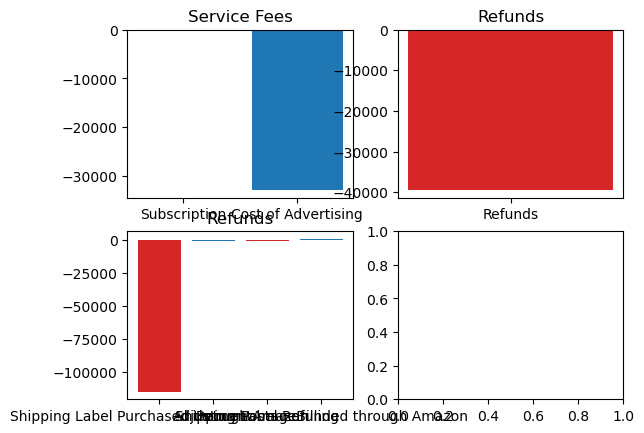

In [174]:
values1=[round(df.loc[df['description']=='Subscription']['other'].sum(),2),round(df.loc[df['description']=='Cost of Advertising']['other transaction fees'].sum(),2)]
cat1 = ['Subscription','Cost of Advertising']

values2 =[df.loc[df['type']=='Refund'].total.sum()]
cat2 =['Refunds']

values3 =[round(df.loc[df['description']=='Shipping Label Purchased through Amazon'].total.sum(),2),round(df.loc[df['description']=='Adjustment'].total.sum(),2), \
         round(df.loc[df['description']=='ReturnPostageBilling'].total.sum(),2),round(df.loc[df['description']== 'Shipping Label Refunded through Amazon'].total.sum(),2)]
cat3 =['Shipping Label Purchased through Amazon', 'Adjustment','ReturnPostageBilling', 'Shipping Label Refunded through Amazon']

values4 =[round(df.loc[df['description']=='FBA Amazon-Partnered Carrier Shipment Fee'].total.sum(),2)]
cat4 =['FBA Amazon-Partnered Carrier Shipment Fee']

fig, ax = plt.subplots(2,2)

bar_colors = ['tab:red', 'tab:blue']

ax[0,0].bar(cat1, values1, color=bar_colors)
ax[0,0].set_title("Service Fees") 

ax[0,1].bar(cat2, values2, color=bar_colors)
ax[0,1].set_title("Refunds")

ax[1,0].bar(cat3, values3, color=bar_colors)
ax[1,0].set_title("Refunds")



In [142]:
[round(df.loc[df['description']=='Subscription']['other'].sum(),2),round(df.loc[df['description']=='Cost of Advertising']['other transaction fees'].sum(),2)]

[-192.53, -32833.25]

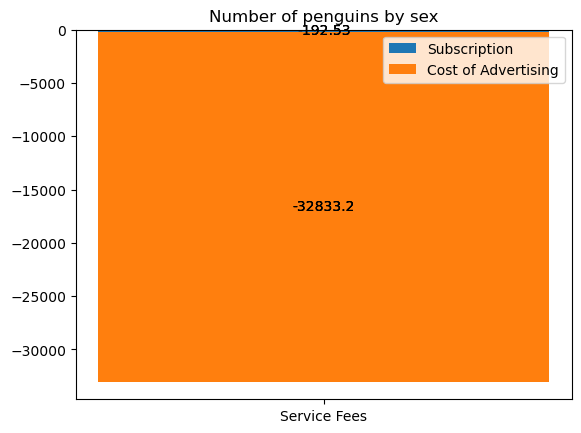

In [148]:
species = ('Service Fees')
sex_counts = {
    'Subscription': [round(df.loc[df['description']=='Subscription']['other'].sum(),2)],
    'Cost of Advertising': [ round(df.loc[df['description']=='Cost of Advertising']['other transaction fees'].sum(),2)],
}
width = 0.6  # the width of the bars: can also be len(x) sequence


fig, ax = plt.subplots()
bottom = np.zeros(3)

for sex, sex_count in sex_counts.items():
    p = ax.bar(species, sex_count, width, label=sex, bottom=bottom)
    bottom += sex_count

    ax.bar_label(p, label_type='center')

ax.set_title('Number of penguins by sex')
ax.legend()

plt.show()

In [265]:
#get column sums
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45981 entries, 0 to 45980
Data columns (total 30 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   date/time                 45981 non-null  object 
 1   settlement id             45981 non-null  int64  
 2   type                      45981 non-null  object 
 3   order id                  45609 non-null  object 
 4   sku                       33477 non-null  object 
 5   description               45981 non-null  object 
 6   quantity                  33325 non-null  float64
 7   marketplace               33422 non-null  object 
 8   account type              45981 non-null  object 
 9   fulfillment               33100 non-null  object 
 10  order city                33094 non-null  object 
 11  order state               33054 non-null  object 
 12  order postal              33093 non-null  object 
 13  tax collection model      30232 non-null  object 
 14  produc

In [290]:
df['total'].sum()

6748.400000000049

In [288]:
df_not = df[df['other']!=0.0]

In [289]:
df_not['type'].unique()

array(['Shipping Services', 'FBA Inventory Fee', 'Adjustment', 'Transfer',
       'Refund', 'Service Fee'], dtype=object)